# Knowing the probability of the dataset and varying the hyper-parameters

In [1]:
import os, sys, importlib.util

# 1) Where Jupyter is currently running:
cwd = os.getcwd()
print("Notebook cwd:", cwd)

# 2) Compute the folder above (your project root):
project_root = os.path.abspath(os.path.join(cwd, os.pardir))
print("Project root:", project_root)
print("→ Contains:", os.listdir(project_root))

# 3) Inject it onto sys.path (highest priority):
if project_root not in sys.path:
    sys.path.insert(0, project_root)
print("After hack, sys.path[0]:", sys.path[0])

# 4) Confirm Python can now see lmt_pkg:
print("After hack, spec(lmt_pkg):", importlib.util.find_spec("lmt_pkg"))

from lmt_pkg import lmt_final_implementation as lmt
from lmt_pkg import calibration_functions as calibration
from lmt_pkg import logitboost_j_implementation as logitboost


Notebook cwd: c:\Users\allis\Desktop\MITACS\LMT-calibration\Calibration testing
Project root: c:\Users\allis\Desktop\MITACS\LMT-calibration
→ Contains: ['.git', 'Calibration testing', 'Construction and tests', 'Documentation', 'lmt_pkg', 'Papers', 'README.md']
After hack, sys.path[0]: c:\Users\allis\Desktop\MITACS\LMT-calibration
After hack, spec(lmt_pkg): ModuleSpec(name='lmt_pkg', loader=<_frozen_importlib_external.SourceFileLoader object at 0x000002D1FFD6B790>, origin='c:\\Users\\allis\\Desktop\\MITACS\\LMT-calibration\\lmt_pkg\\__init__.py', submodule_search_locations=['c:\\Users\\allis\\Desktop\\MITACS\\LMT-calibration\\lmt_pkg'])


In [2]:
import numpy as np
import pandas as pd
from scipy.special import expit   # the sigmoid function
from sklearn.linear_model import LogisticRegression
from sklearn.calibration import calibration_curve
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score, log_loss
from sklearn.calibration import CalibrationDisplay
from matplotlib.gridspec import GridSpec

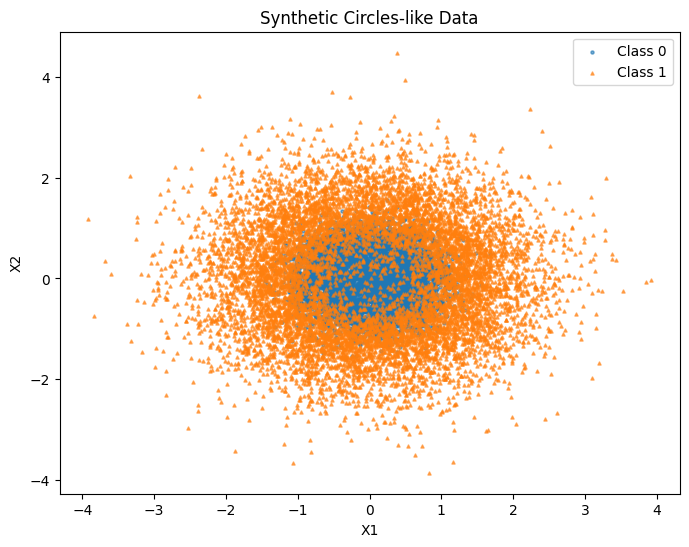

In [3]:
# 1) PARAMETERS
n = 15000
alpha = 3.0  # controls sharpness of the circle boundary
r0 = 1    # target radius

# 2) SIMULATE FEATURES from a normal distribution
np.random.seed(42)  # for reproducibility
X1 = np.random.normal(0, 1, n)
X2 = np.random.normal(0, 1, n)
r2 = X1**2 + X2**2

# 3) DEFINE TRUE PROBABILITIES USING A SIGMOID ON r^2 - r0
p = 1 / (1 + np.exp(-alpha * (r2 - r0)))

# 4) SAMPLE OUTCOME y ~ Bernoulli(p)
y = np.random.binomial(1, p)

# 5) SCATTER PLOT
classes = np.unique(y)
plt.figure(figsize=(8,6))
for cls, marker in zip(classes, ['o','^']):
    plt.scatter(
        X1[y==cls], 
        X2[y==cls], 
        alpha=0.6, 
        marker=marker, 
        label=f'Class {int(cls)}',
        s=5
    )

plt.legend()
plt.xlabel('X1')
plt.ylabel('X2')
plt.title('Synthetic Circles-like Data')
plt.show()

In [4]:
(y.sum()) / n  # proportion of positive class

0.6232666666666666

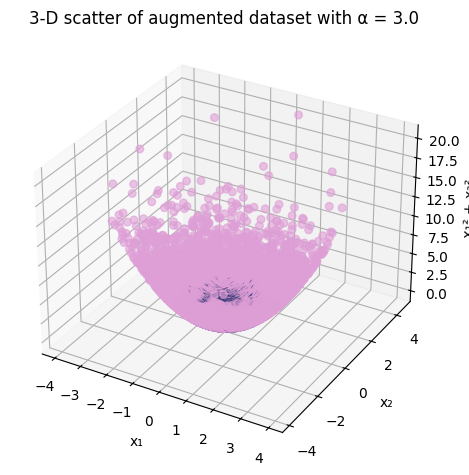

In [5]:
# Full dataset
X = np.column_stack((X1, X2))   # now X has shape (n,2)
# extend X with that third column
X_ext = np.column_stack((X, r2))  # shape (n,3)

fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# X_ext  → shape (n_samples, 3)
# y      → 1-D array of class labels you got from make_blobs
ax.scatter(X_ext[:, 0], X_ext[:, 1], X_ext[:, 2], c=y, alpha=0.6, cmap=plt.cm.tab20b, s=30)

ax.set_xlabel("x₁")
ax.set_ylabel("x₂")
ax.set_zlabel("x₁² + x₂²")
plt.title(f"3-D scatter of augmented dataset with α = {alpha}")
plt.tight_layout()
plt.show()

In [6]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_ext, y, test_size=0.3, random_state=42)

## LogitBoost $J$ classes

In [43]:
# Fit the LogitBoost model
learners1, J1 = logitboost.logitboost_fit(X_train[:,:2], y_train, n_estimators=500)

# Predict using the fitted model on test set
y_pred1 = logitboost.logitboost_predict(X_test[:,:2], learners1, J1)
y_proba1 = logitboost.logitboost_predict_proba(X_test[:,:2], learners1, J1)

# Evaluate the model
acc1 = accuracy_score(y_test, y_pred1)
roc1 = roc_auc_score(y_test, y_proba1[:, 1])
log_loss1 = log_loss(y_test, y_proba1)

# Print results for original make_circles
print(f"Log-loss on original make_circles: {log_loss1:.4f}")
print(f"Accuracy on original make_circles: {acc1:.4f}")
print(f"ROC AUC on original make_circles: {roc1:.4f}")

Log-loss on original make_circles: 0.6683
Accuracy on original make_circles: 0.6122
ROC AUC on original make_circles: 0.5035


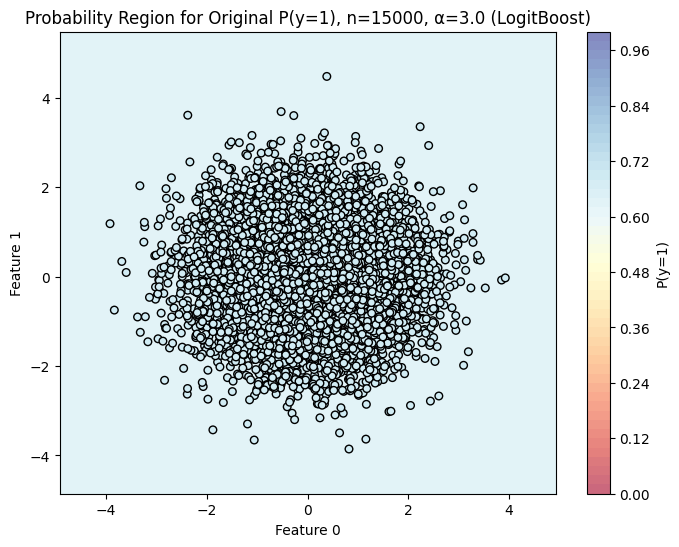

In [44]:
ax, contour = logitboost.plot_probability_region_logit(
    X_train[:,:2], y_train,
    learners1, J1,
    feature_pair=(0,1),
    prob_class=1,
    fill_value="mean",
    h=0.02,
    cmap="RdYlBu",
    title=f"Probability Region for Original P(y=1), n={n}, α={alpha} (LogitBoost)",
)
plt.show()

In [45]:
# Fit the LogitBoost model
learners2, J2 = logitboost.logitboost_fit(X_train, y_train, n_estimators=500)

# Predict using the fitted model on test set
y_pred2 = logitboost.logitboost_predict(X_test, learners2, J2)
y_proba2 = logitboost.logitboost_predict_proba(X_test, learners2, J2)

# Evaluate the model
acc2 = accuracy_score(y_test, y_pred2)
log_loss2 = log_loss(y_test, y_proba2)
roc2 = roc_auc_score(y_test, y_proba2[:, 1])

# Print results for extended make_circles
print(f"Log-loss on extended make_circles: {log_loss2:.4f}")
print(f"Accuracy on extended make_circles: {acc2:.4f}")
print(f"ROC AUC on extended make_circles: {roc2:.4f}")

Log-loss on extended make_circles: 0.2947
Accuracy on extended make_circles: 0.8680
ROC AUC on extended make_circles: 0.9429


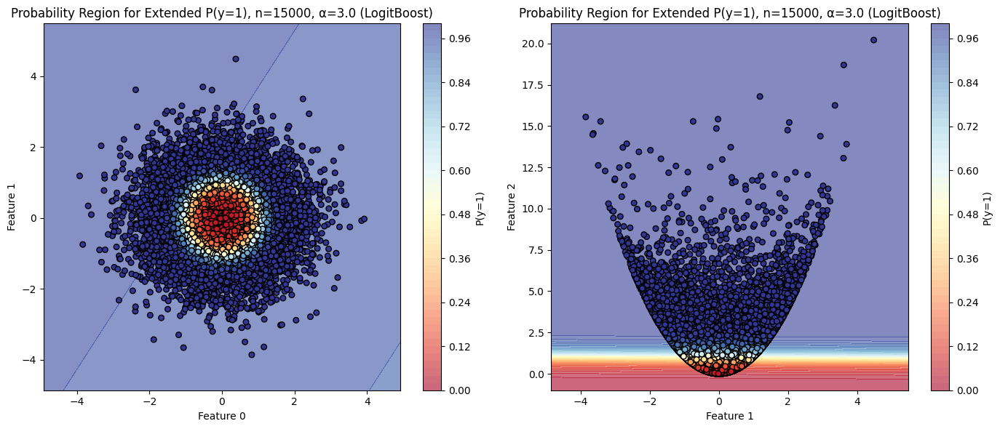

In [46]:
# Subplots to show the probability regions for both pairs of features
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# For feature pair (0, 1)
# Put it in the first subplot
_, contour1 = logitboost.plot_probability_region_logit(
    X_train, y_train,
    learners2, J2,
    feature_pair=(0,1),
    prob_class=1,
    fill_value="mean",
    h=0.02,
    cmap="RdYlBu",
    title=f"Probability Region for Extended P(y=1), n={n}, α={alpha} (LogitBoost)",
    ax=ax[0]
)

# For feature pair (1, 2)
_, contour2 = logitboost.plot_probability_region_logit(
    X_train, y_train,
    learners2, J2,
    feature_pair=(1,2),
    prob_class=1,
    fill_value="mean",
    h=0.02,
    cmap="RdYlBu",
    title=f"Probability Region for Extended P(y=1), n={n}, α={alpha} (LogitBoost)",
    ax=ax[1]
)
plt.tight_layout()
plt.show()

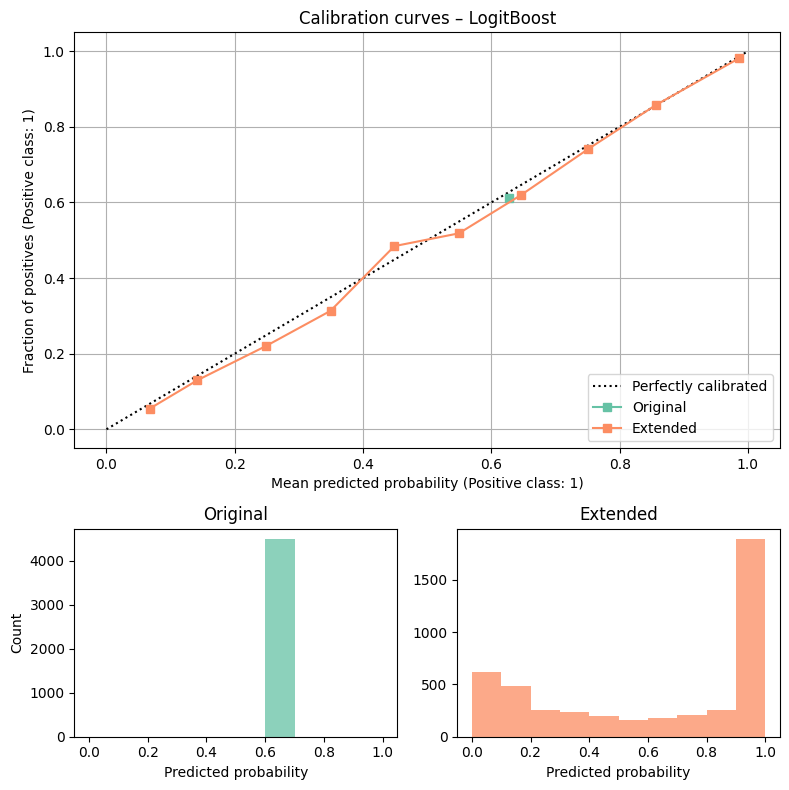

In [47]:
# --- 1) recover true p_i on the test set --------------------
# assuming X_test is shape (n_test,2) for the original features
# and your true probabilities only depend on x1^2 + x2^2:
r2_test = X_test[:,0]**2 + X_test[:,1]**2
p_true  = expit(alpha * (r2_test - r0))

# --- 2) calibration curves (10 bins) ------------------------
# Get class-probability estimates for each model
#  -> keep only the probability of the positive class (column 1)
proba_orig = logitboost.logitboost_predict_proba(X_test[:,:2], learners1, J1)[:, 1]
proba_ext  = logitboost.logitboost_predict_proba(X_test, learners2, J2)[:, 1]

fig = plt.figure(figsize=(8, 8))
gs  = GridSpec(nrows=2, ncols=2, height_ratios=[2, 1])

ax_curve = fig.add_subplot(gs[0, :])                 # big panel for the curves
ax_hist1 = fig.add_subplot(gs[1, 0])                 # histogram – model 1
ax_hist2 = fig.add_subplot(gs[1, 1])                 # histogram – model 2
colors   = plt.get_cmap("Set2")

# ―― Curve for the ORIGINAL data ――
CalibrationDisplay.from_predictions(
    y_test,           # true labels (binary, 0 / 1)
    proba_orig,       # predicted prob of class 1
    n_bins=10,
    name="Original",
    ax=ax_curve,
    color=colors(0),
)

# ―― Curve for the EXTENDED data ――
CalibrationDisplay.from_predictions(
    y_test,
    proba_ext,
    n_bins=10,
    name="Extended",
    ax=ax_curve,
    color=colors(1),
)

ax_curve.set_title("Calibration curves – LogitBoost")
ax_curve.grid(True)
ax_hist1.hist(proba_orig, bins=10, range=(0, 1),
              color=colors(0), alpha=0.75)
ax_hist1.set(title="Original", xlabel="Predicted probability", ylabel="Count")

ax_hist2.hist(proba_ext,  bins=10, range=(0, 1),
              color=colors(1), alpha=0.75)
ax_hist2.set(title="Extended", xlabel="Predicted probability")

fig.tight_layout()
plt.show()


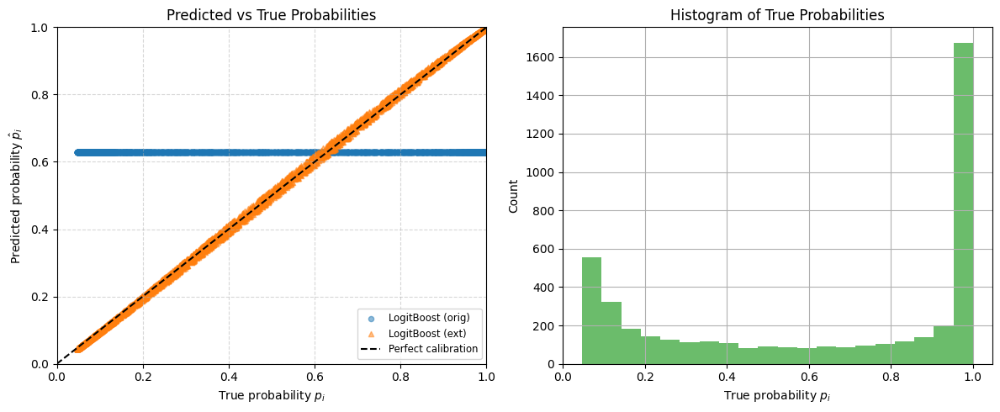

In [48]:
calibration.plot_pred_vs_true(
    models={
        'LogitBoost (orig)': (learners1, J1),
        'LogitBoost (ext)': (learners2, J2),
    },
    p_true=p_true,
    X_test=X_test,
    model_type='logitboost'
)


C:\Users\allis\AppData\Local\Temp\ipykernel_2528\1263146406.py:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap('Spectral', n_quantiles)


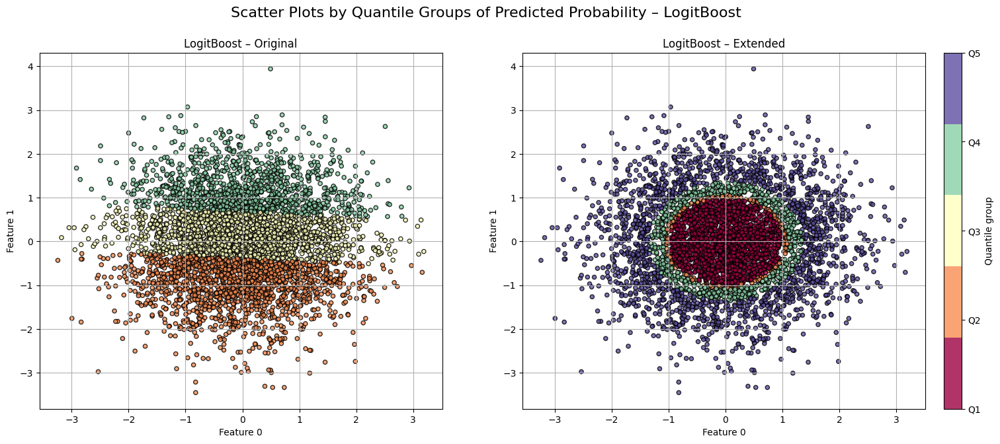

In [49]:
# 1. Get model probabilities
y_proba1 = logitboost.logitboost_predict_proba(X_test[:, :2], learners1, J1)[:, 1]
y_proba2 = logitboost.logitboost_predict_proba(X_test, learners2, J2)[:, 1]

# 2. Define consistent binning, norm, and colormap
n_quantiles = 5
all_probs = np.concatenate([y_proba1, y_proba2])
q_edges = np.quantile(all_probs, np.linspace(0, 1, n_quantiles + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=n_quantiles - 1)
cmap = mpl.cm.get_cmap('Spectral', n_quantiles)

# 3. Create subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 7))

# 4. Plot each scatter with shared binning
scatter1 = calibration.plot_scatter_by_quantile(
    X_test[:, :2],
    y_proba1,
    n_quantiles=n_quantiles,
    title="LogitBoost – Original",
    ax=axes[0],
    cmap=cmap,
    norm=norm,
    q_edges=q_edges
)

scatter2 = calibration.plot_scatter_by_quantile(
    X_test[:, :2],
    y_proba2,
    n_quantiles=n_quantiles,
    title="LogitBoost – Extended",
    ax=axes[1],
    cmap=cmap,
    norm=norm,
    q_edges=q_edges
)

# 5. Shared colorbar
cbar = fig.colorbar(scatter2, ax=axes, orientation="vertical", fraction=0.02, pad=0.02)
cbar.set_label("Quantile group")
cbar.set_ticks(range(n_quantiles))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(n_quantiles)])

fig.suptitle("Scatter Plots by Quantile Groups of Predicted Probability – LogitBoost", fontsize=16)
plt.show()


## Decision Trees $C4.5$

Shallow Tree (No Pruning) - Accuracy: 0.6551, AUC: 0.7134, Log Loss: 0.5457
Regular Tree (No Pruning) - Accuracy: 0.8338, AUC: 0.8945, Log Loss: 2.0424
Overfit Tree (No Pruning) - Accuracy: 0.8207, AUC: 0.8094, Log Loss: 6.4638
Regular Tree (With Pruning) - Accuracy: 0.8649, AUC: 0.9358, Log Loss: 0.3467


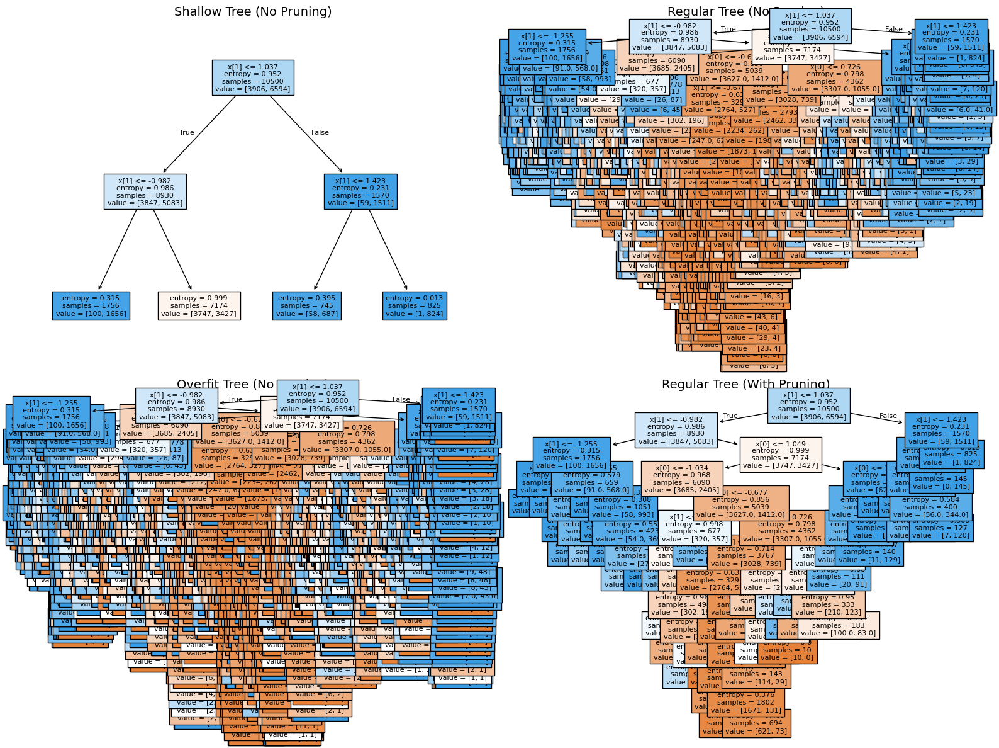

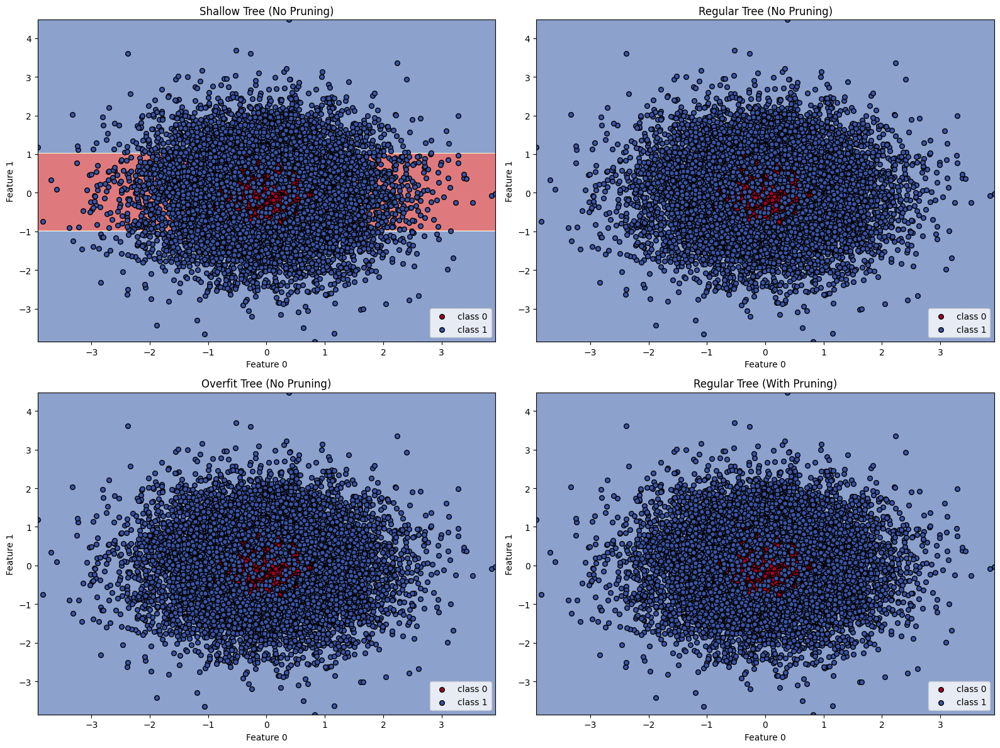

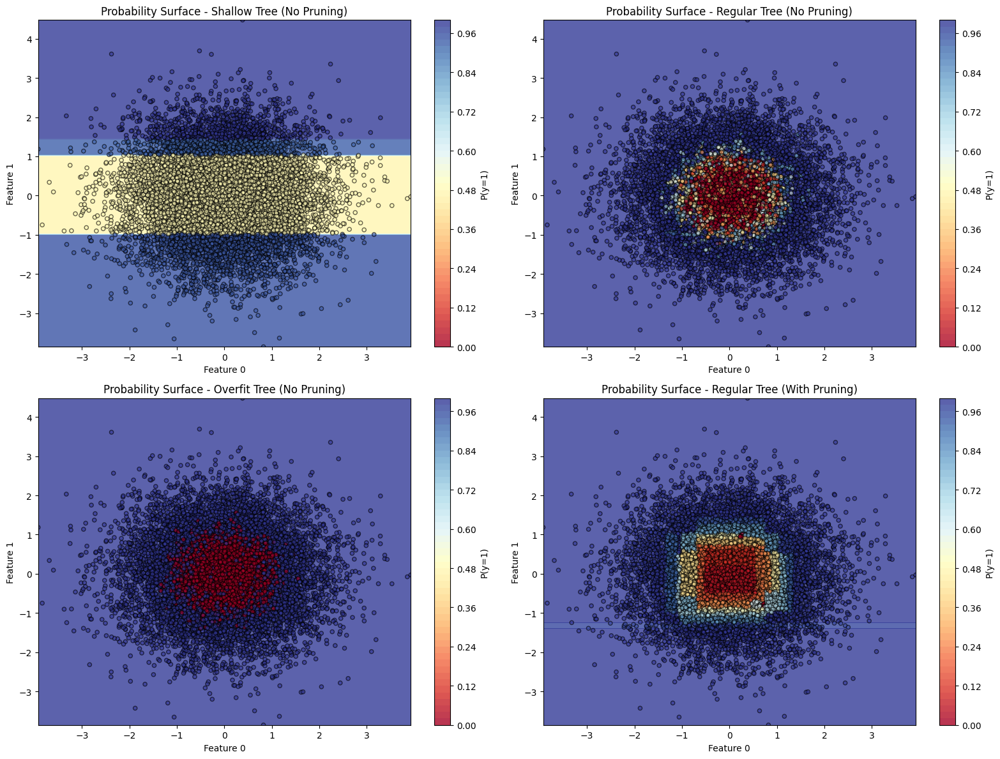

In [50]:
lmt.compare_tree_variants(X_train[:,:2], X_test[:,:2], y_train, y_test, lmt, decision=True, prob_surf=True, feature_pair=(0,1))

Shallow Tree (No Pruning) - Accuracy: 0.8638, AUC: 0.9274, Log Loss: 0.3154
Regular Tree (No Pruning) - Accuracy: 0.8398, AUC: 0.8952, Log Loss: 2.2138
Overfit Tree (No Pruning) - Accuracy: 0.8144, AUC: 0.8015, Log Loss: 6.6881
Regular Tree (With Pruning) - Accuracy: 0.8689, AUC: 0.9396, Log Loss: 0.3005


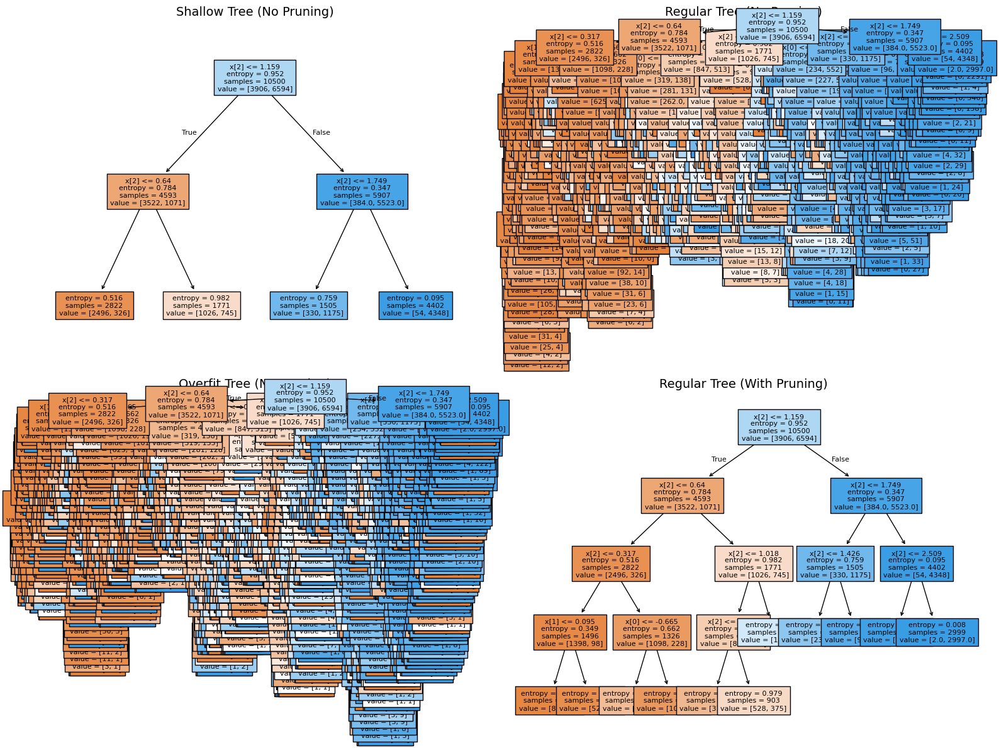

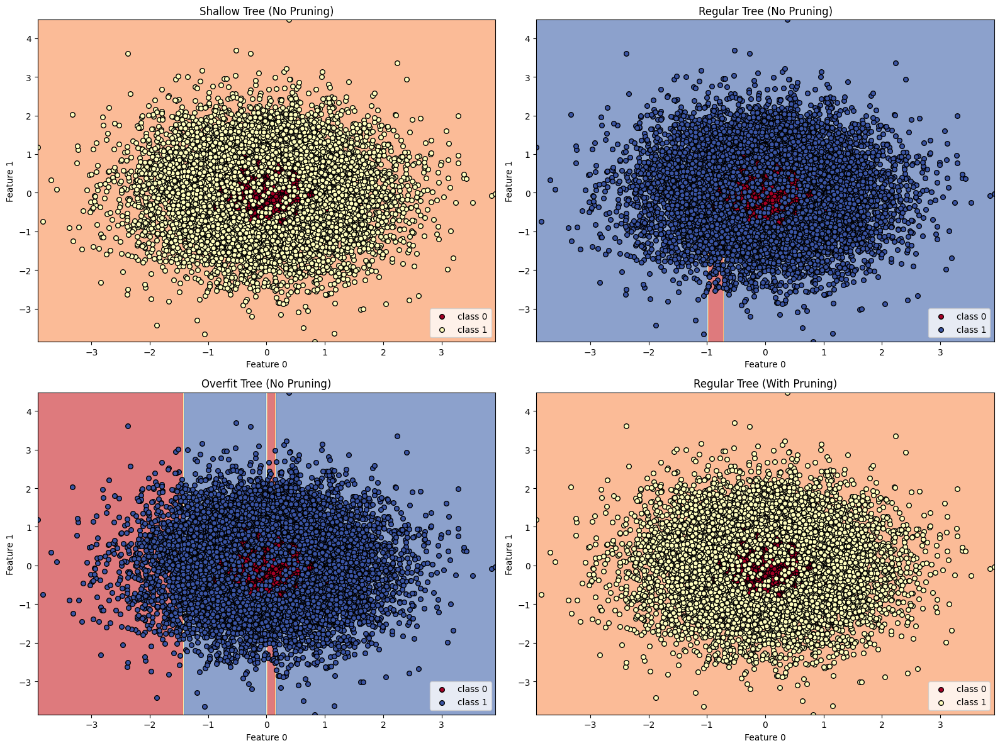

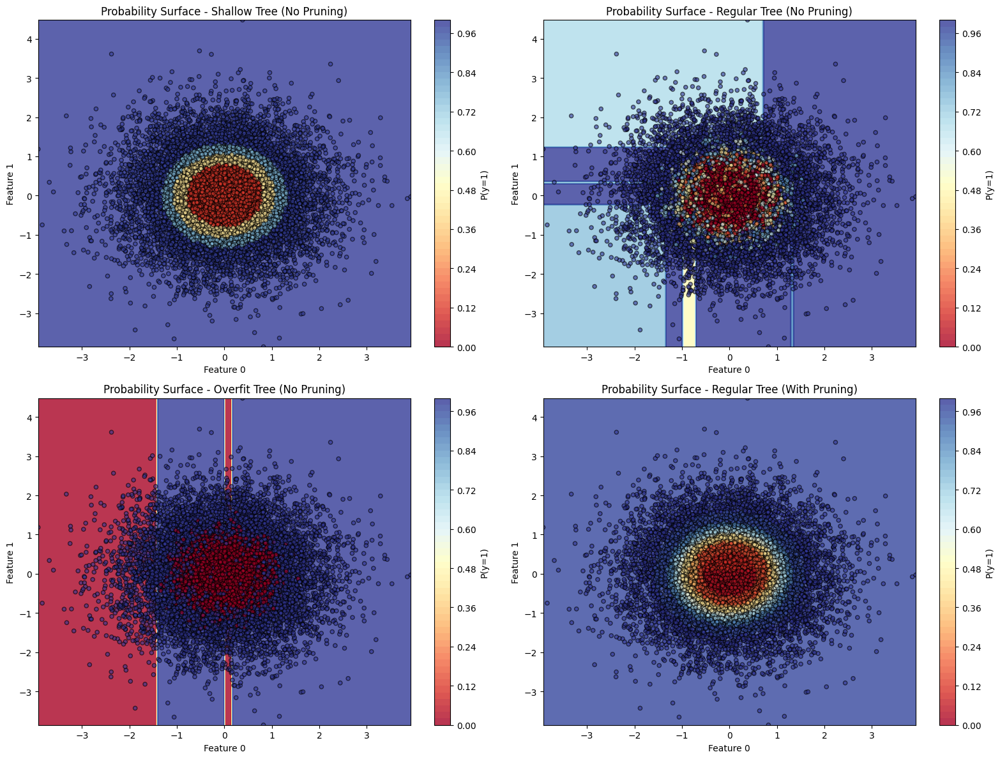

In [51]:
lmt.compare_tree_variants(X_train, X_test, y_train, y_test, lmt, decision=True, prob_surf=True, feature_pair=(0,1))

Shallow Tree (No Pruning) - Accuracy: 0.8638, AUC: 0.9274, Log Loss: 0.3154
Regular Tree (No Pruning) - Accuracy: 0.8398, AUC: 0.8952, Log Loss: 2.2138
Overfit Tree (No Pruning) - Accuracy: 0.8144, AUC: 0.8015, Log Loss: 6.6881
Regular Tree (With Pruning) - Accuracy: 0.8689, AUC: 0.9396, Log Loss: 0.3005


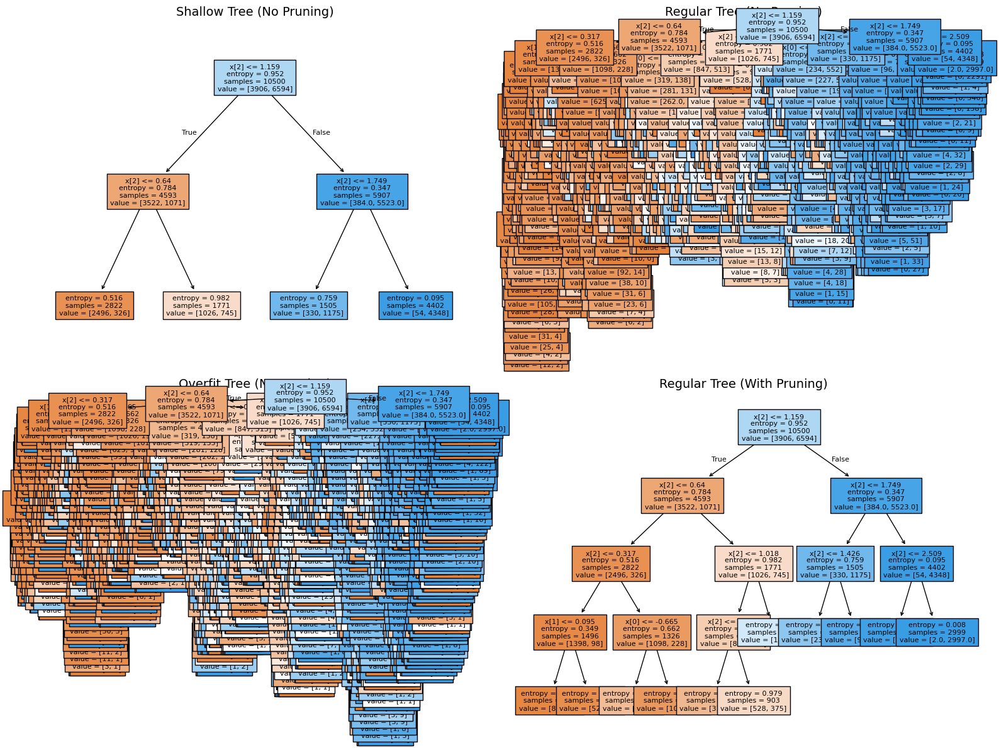

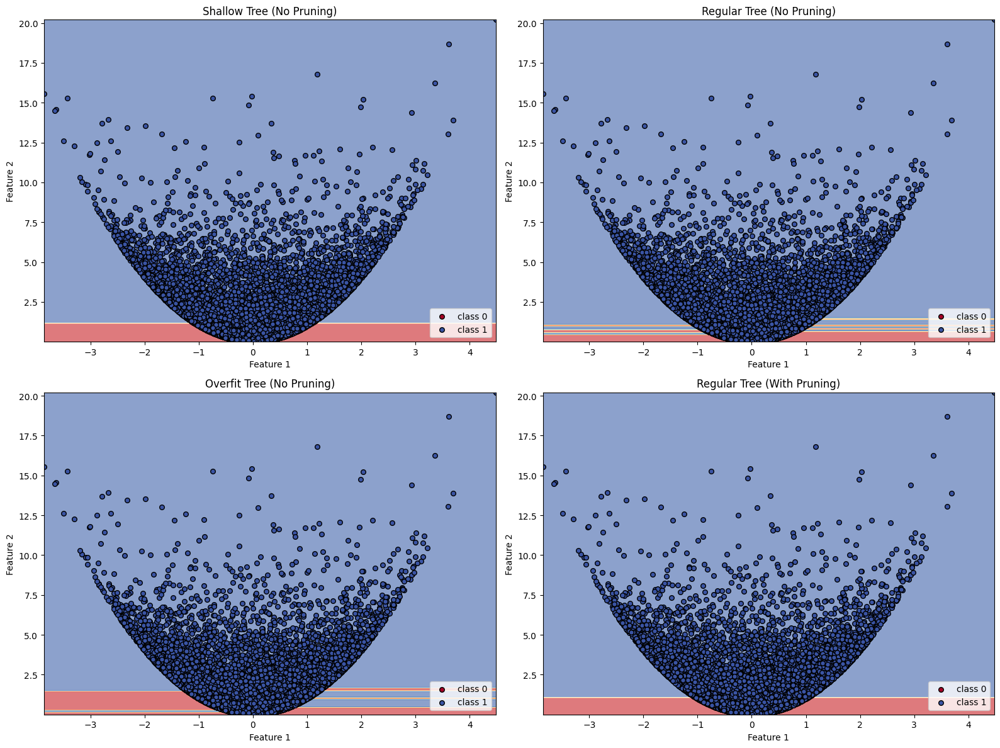

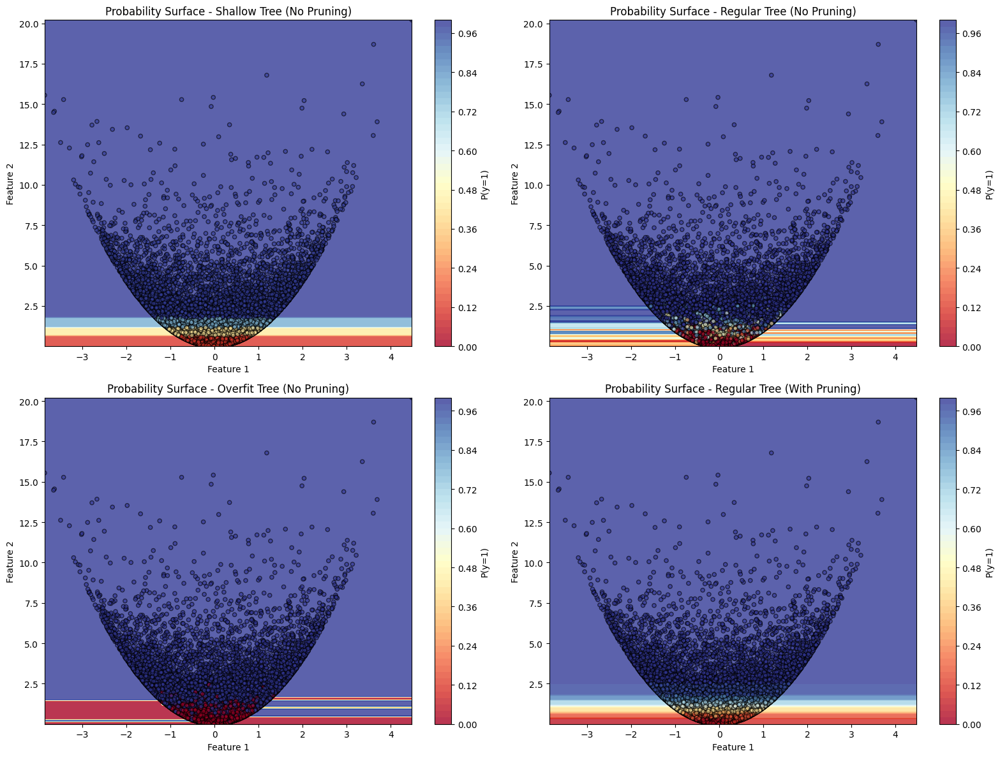

In [52]:
lmt.compare_tree_variants(X_train, X_test, y_train, y_test, lmt, decision=True, prob_surf=True, feature_pair=(1,2))

In [53]:
clf_shallow     = lmt.construct_tree(X_train[:,:2],     y_train,     size='shallow', pruning=False)
clf_regular     = lmt.construct_tree(X_train[:,:2],     y_train,     size='regular', pruning=False)
clf_overfit     = lmt.construct_tree(X_train[:,:2],     y_train,     size='overfit', pruning=False)
clf_pruned      = lmt.construct_tree(X_train[:,:2],     y_train,     size='regular', pruning=True)

clf_shallow_ext = lmt.construct_tree(X_train, y_train, size='shallow', pruning=False)
clf_regular_ext = lmt.construct_tree(X_train, y_train, size='regular', pruning=False)
clf_overfit_ext = lmt.construct_tree(X_train, y_train, size='overfit', pruning=False)
clf_pruned_ext  = lmt.construct_tree(X_train, y_train, size='regular', pruning=True)

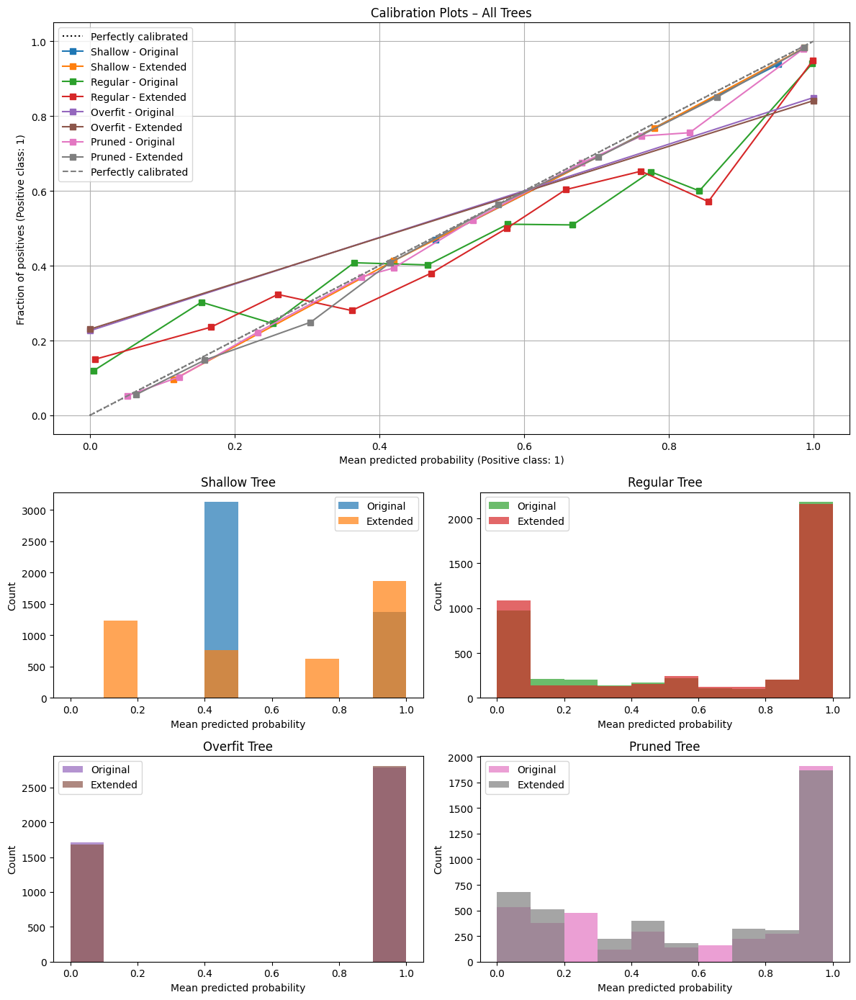

In [54]:
# Call the plotting function
calibration.plot_combined_calibration_and_hists(
    y_test=y_test,
    X_test=X_test[:, :2],
    y_test_ext=y_test,
    X_test_ext=X_test,
    clf_orig_list=[clf_shallow, clf_regular, clf_overfit, clf_pruned],
    clf_ext_list=[clf_shallow_ext, clf_regular_ext, clf_overfit_ext, clf_pruned_ext],
)

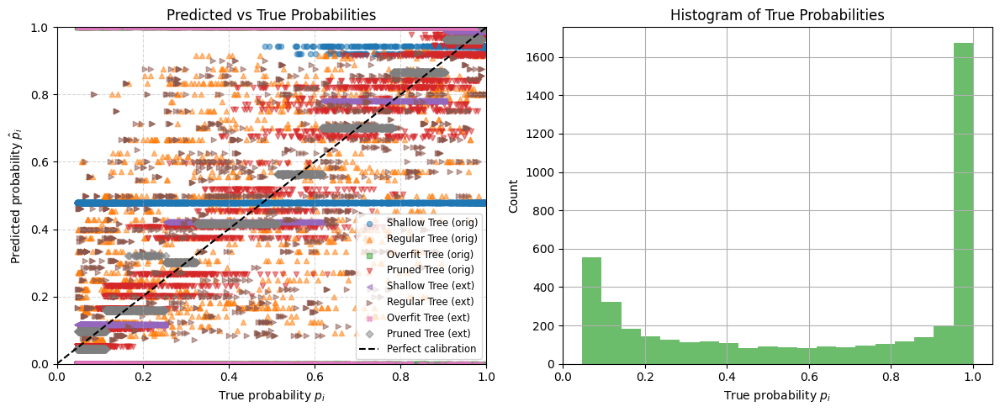

In [55]:
models = {
    "Shallow Tree (orig)": clf_shallow,
    "Regular Tree (orig)": clf_regular,
    "Overfit Tree (orig)": clf_overfit,
    "Pruned Tree (orig)": clf_pruned,
    "Shallow Tree (ext)": clf_shallow_ext,
    "Regular Tree (ext)": clf_regular_ext,
    "Overfit Tree (ext)": clf_overfit_ext,
    "Pruned Tree (ext)": clf_pruned_ext,
}

p_true = expit(alpha * (X_test[:, 0]**2 + X_test[:, 1]**2 - r0))

calibration.plot_pred_vs_true(
    models=models,
    p_true=p_true,
    X_test=X_test,
    model_type='tree',
    orig_cols=2,
    figsize=(12, 5)
)

C:\Users\allis\AppData\Local\Temp\ipykernel_2528\2662123823.py:19: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap(cmap_name, nq)


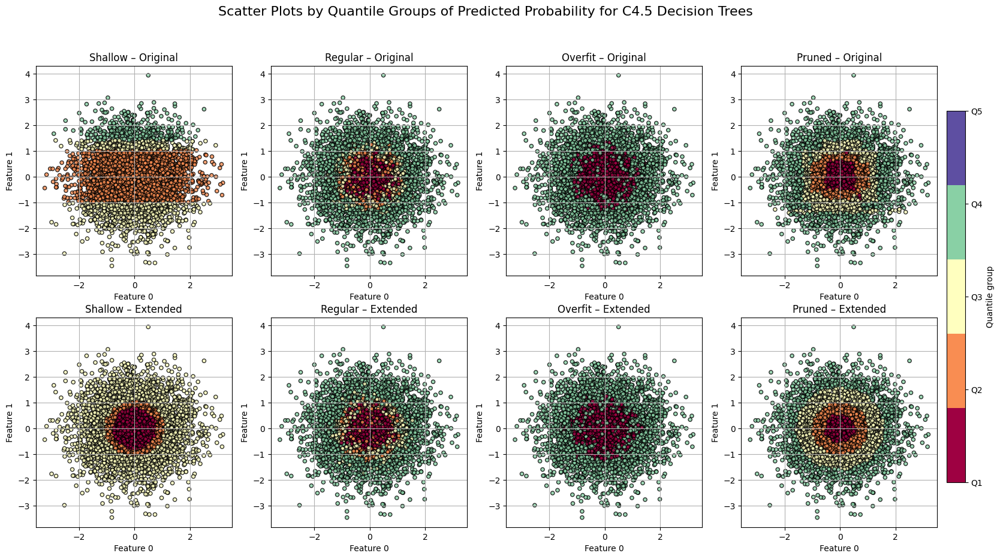

In [56]:
# Step 1: Get predicted probabilities from all models
all_probas = []

for clf in [clf_shallow, clf_regular, clf_overfit, clf_pruned]:
    y_proba = clf.predict_proba(X_test[:, :2])[:, 1]
    all_probas.append(y_proba)

for clf in [clf_shallow_ext, clf_regular_ext, clf_overfit_ext, clf_pruned_ext]:
    y_proba = clf.predict_proba(X_test)[:, 1]
    all_probas.append(y_proba)

all_probas = np.concatenate(all_probas)

# Step 2: Define consistent binning, norm, and colormap
nq = 5
q_edges = np.quantile(all_probas, np.linspace(0, 1, nq + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=nq - 1)
cmap_name = 'Spectral'
cmap = mpl.cm.get_cmap(cmap_name, nq)
model_labels = ["Shallow", "Regular", "Overfit", "Pruned"]

# Step 3: Create subplots
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))

# Top row: original (X_test[:, :2])
for idx, clf in enumerate([clf_shallow, clf_regular, clf_overfit, clf_pruned]):
    y_proba = clf.predict_proba(X_test[:, :2])[:, 1]
    ax = axes[0, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Original",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )

# Bottom row: extended (predict on full X_test, still plot first 2 dims)
for idx, clf in enumerate([clf_shallow_ext, clf_regular_ext, clf_overfit_ext, clf_pruned_ext]):
    y_proba = clf.predict_proba(X_test)[:, 1]
    ax = axes[1, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Extended",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )


# Step 4: Shared colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=axes,
    orientation='vertical',
    fraction=0.02,
    pad=0.01
)
cbar.set_label("Quantile group")
cbar.set_ticks(np.arange(nq))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(nq)])

fig.suptitle("Scatter Plots by Quantile Groups of Predicted Probability for C4.5 Decision Trees", fontsize=16)
plt.show()

## LMT version 1

In [15]:
from tqdm import tqdm
import time

original_models = []

configs = [ 
    ('shallow', False, "shallow (original)"),
    ('regular', False, "regular (original)"),
    ('overfit', False, "overfit (original)"),
    ('regular', True,  "pruned (original)")
]

for size, pruning, label in tqdm(configs, desc="Training original models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf, nodes = lmt.fit_logistic_model_tree(X_train[:, :2], y_train, size=size, pruning=pruning)
        original_models.append((clf, nodes))
        pbar.update(1)
        print(f"{label} done")


Training original models:  25%|██▌       | 1/4 [01:04<03:12, 64.33s/it]

shallow (original) done


Training original models:  50%|█████     | 2/4 [2:53:48<3:24:06, 6123.13s/it]

regular (original) done


Training original models:  50%|█████     | 2/4 [3:47:07<3:47:07, 6813.60s/it]


KeyboardInterrupt: 

Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.6073, Log Loss: 0.5970
Regular Tree (No Pruning) → Accuracy: 0.8156, Log Loss: 2.8912
Overfit Tree (No Pruning) → Accuracy: 0.8207, Log Loss: 6.4638
Regular Tree (With Pruning) → Accuracy: 0.6284, Log Loss: 0.5945


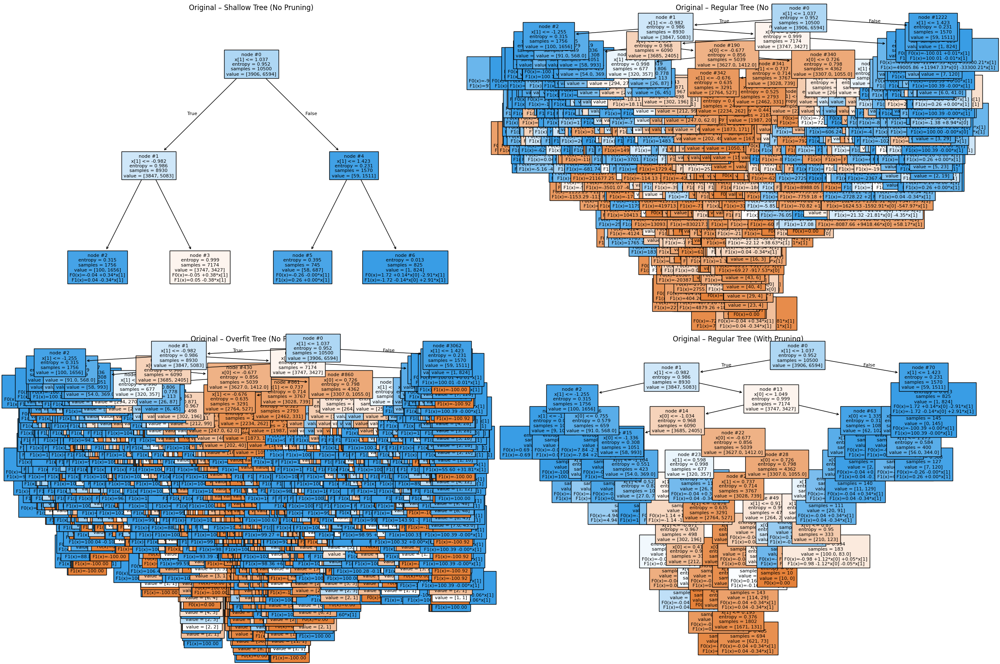

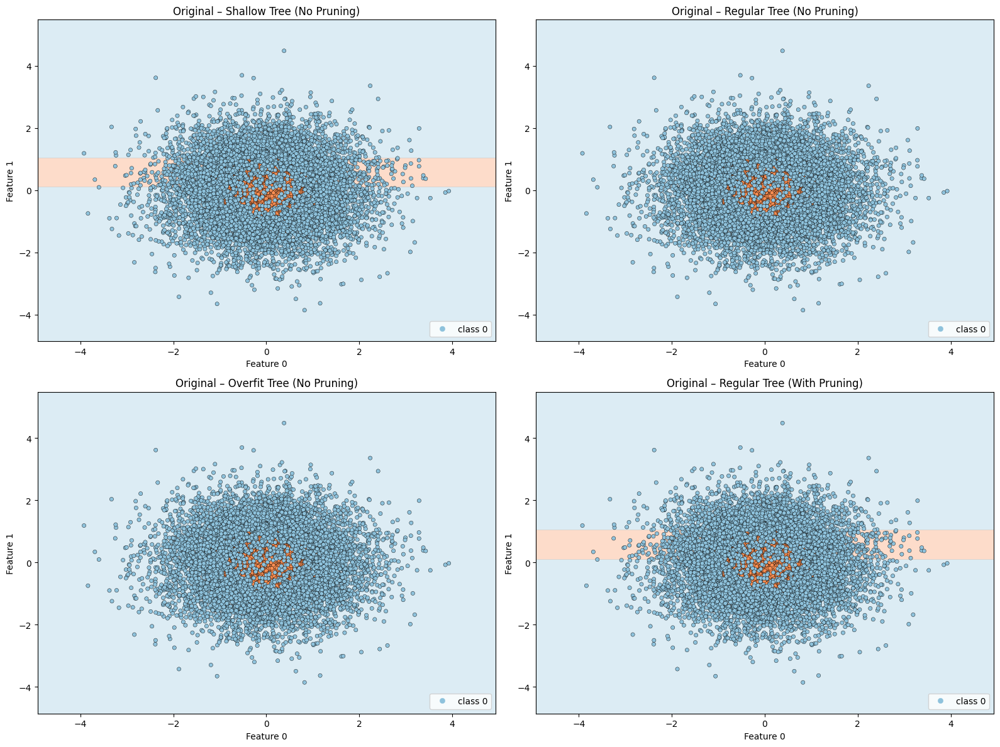

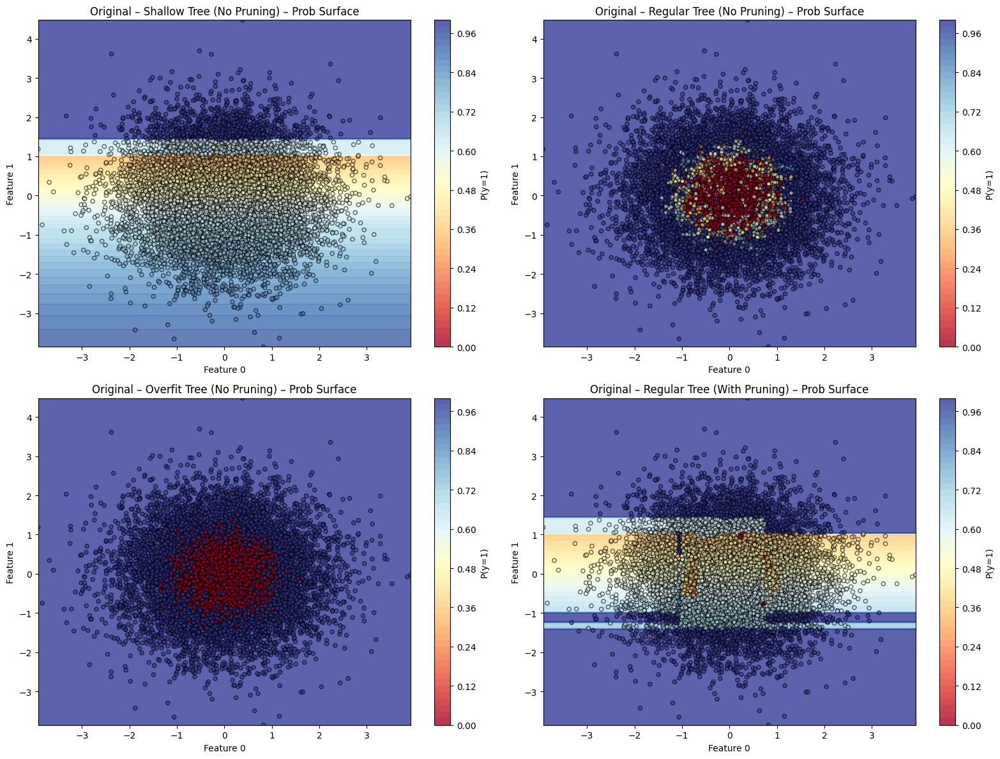

In [ ]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train[:, :2],   # training data used for those models
    X_test=X_test[:, :2],     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v1',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=original_models
)

In [ ]:
extended_models = []

configs = [
    ('shallow', False, "shallow (extended)"),
    ('regular', False, "regular (extended)"),
    ('overfit', False, "overfit (extended)"),
    ('regular', True,  "pruned (extended)")
]

for size, pruning, label in tqdm(configs, desc="Training extended models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf, nodes = lmt.fit_logistic_model_tree(X_train, y_train, size=size, pruning=pruning)
        extended_models.append((clf, nodes))
        pbar.update(1)
        print(f"{label} done")

Training extended models:   0%|          | 0/4 [00:00<?, ?it/s]

Training extended models:  25%|██▌       | 1/4 [00:55<02:45, 55.21s/it]

shallow (original) done


Training extended models:  50%|█████     | 2/4 [1:24:34<1:39:11, 2975.54s/it]

regular (original) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8693, Log Loss: 0.4649
Regular Tree (No Pruning) → Accuracy: 0.8193, Log Loss: 3.1760
Overfit Tree (No Pruning) → Accuracy: 0.8100, Log Loss: 6.8483
Regular Tree (With Pruning) → Accuracy: 0.8693, Log Loss: 0.5432


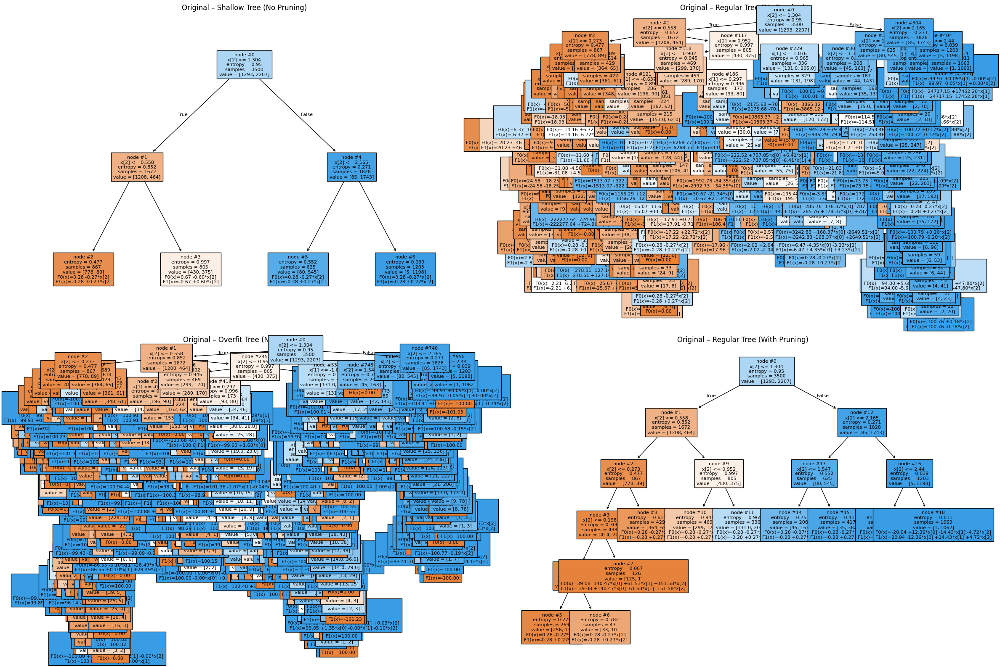

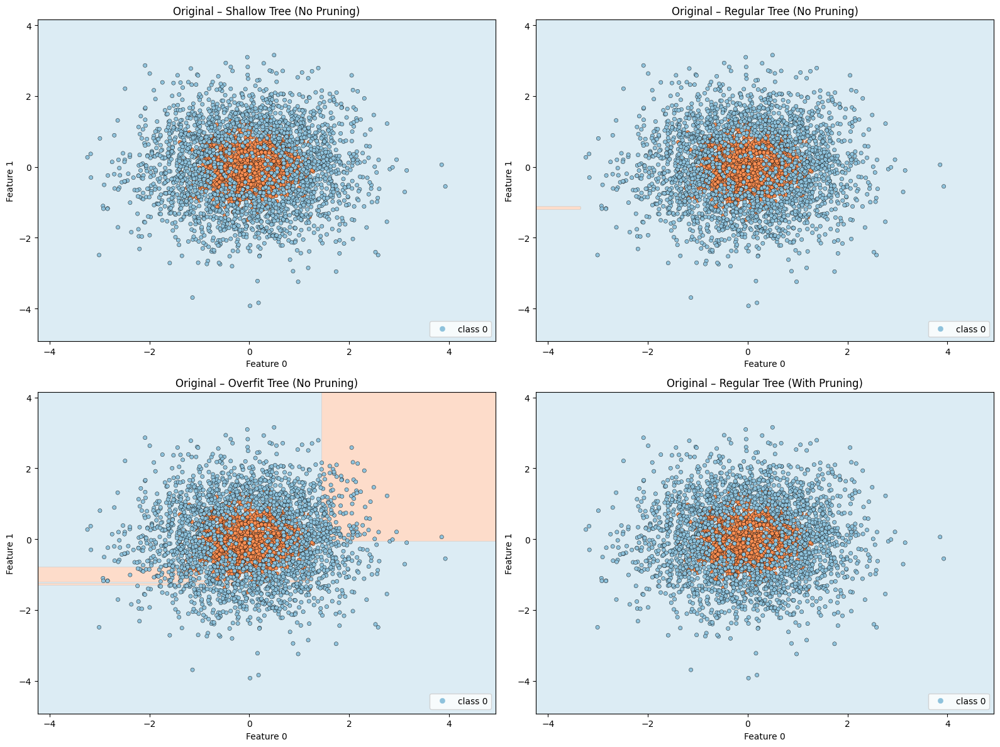

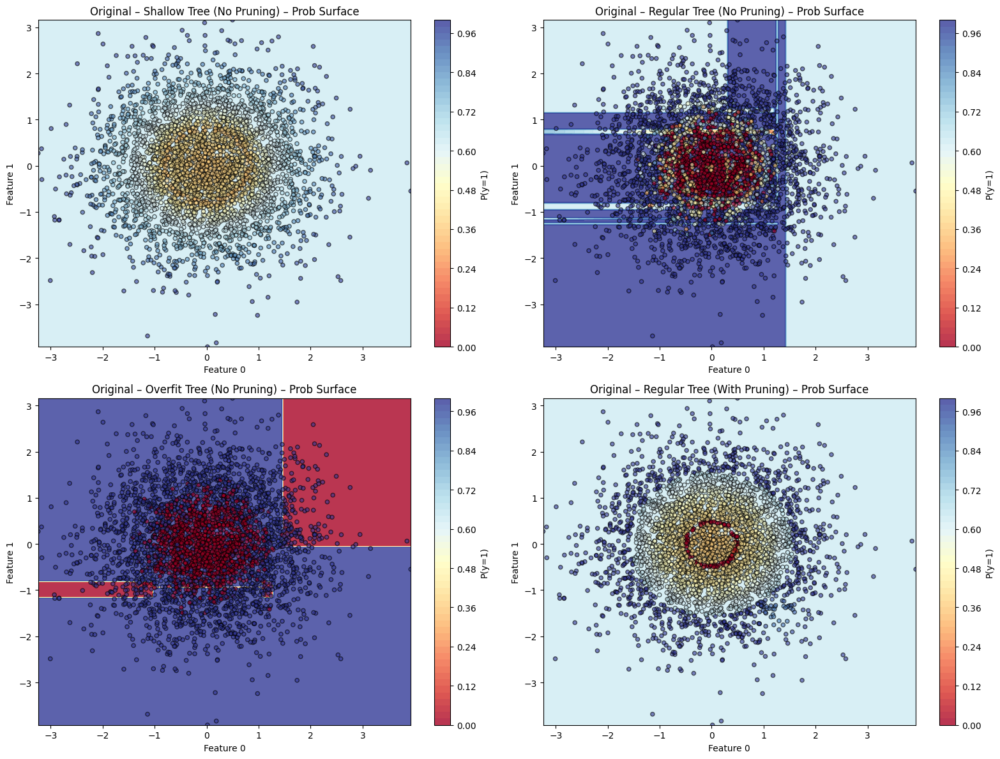

In [ ]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt, 
    version='v1',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=extended_models
)

Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8693, Log Loss: 0.4649
Regular Tree (No Pruning) → Accuracy: 0.8193, Log Loss: 3.1760
Overfit Tree (No Pruning) → Accuracy: 0.8100, Log Loss: 6.8483
Regular Tree (With Pruning) → Accuracy: 0.8693, Log Loss: 0.5432


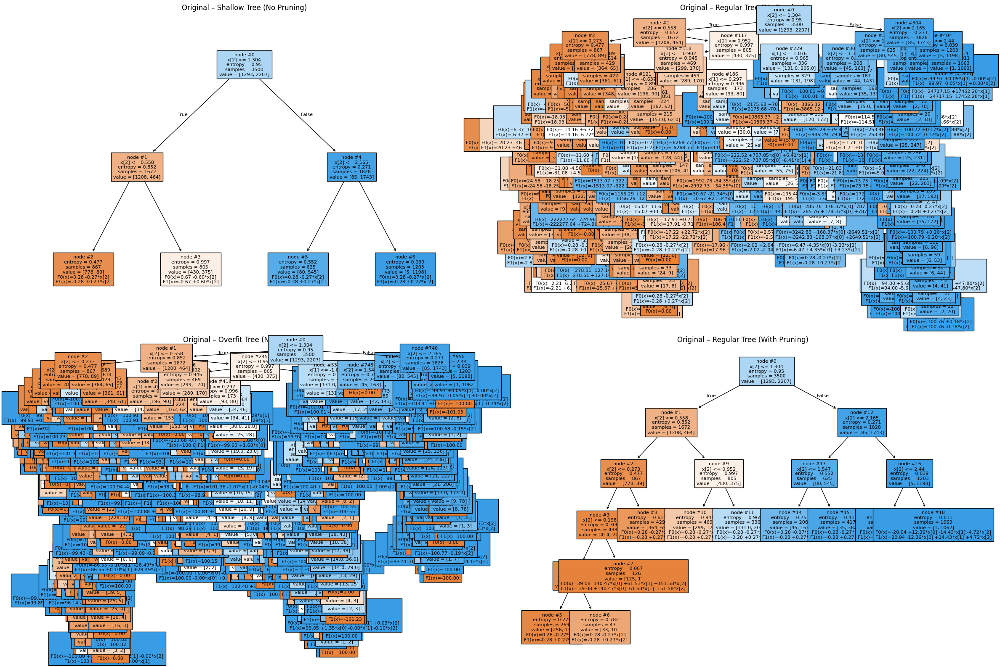

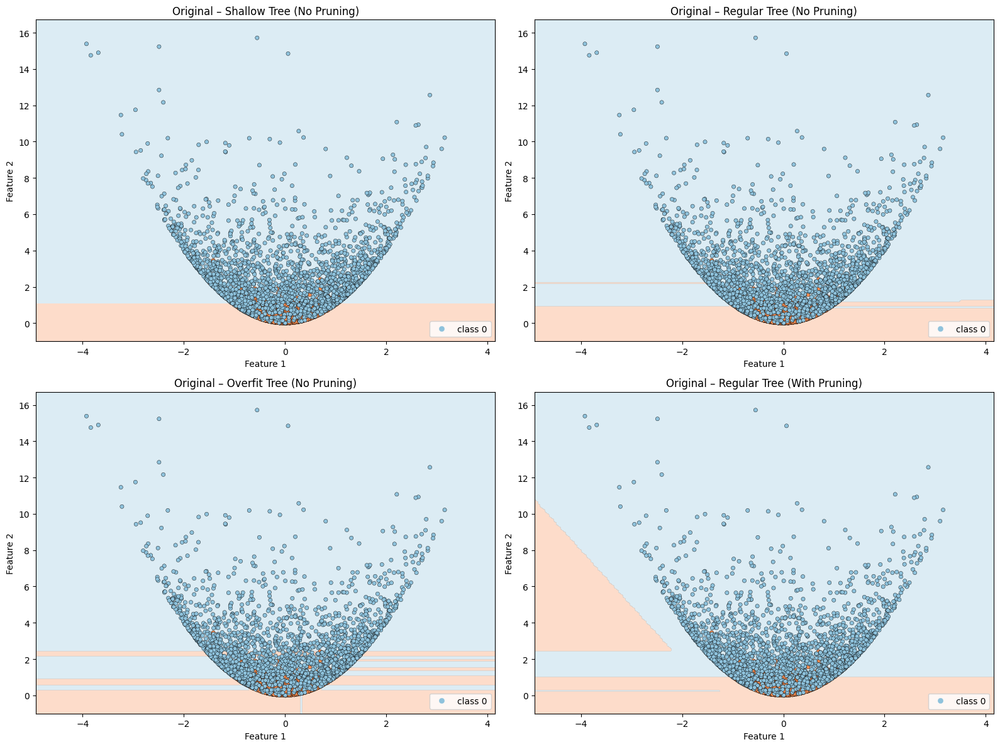

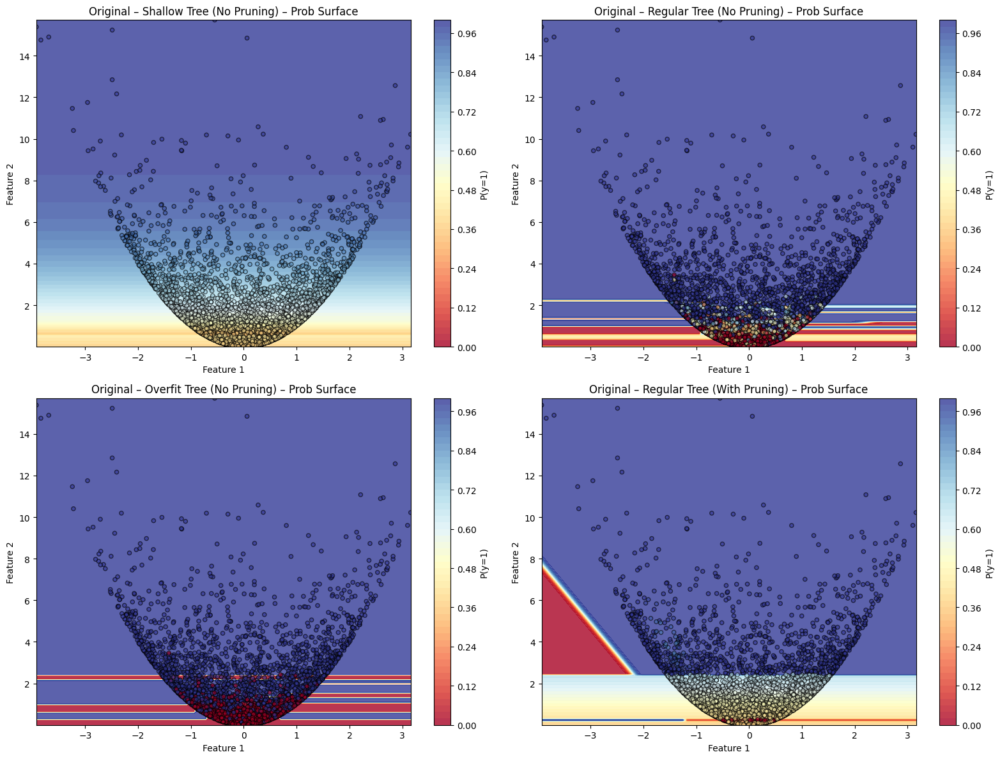

In [ ]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v1',
    decision=True,
    prob_surf=True,
    feature_pair=(1, 2),
    original_models=extended_models
)

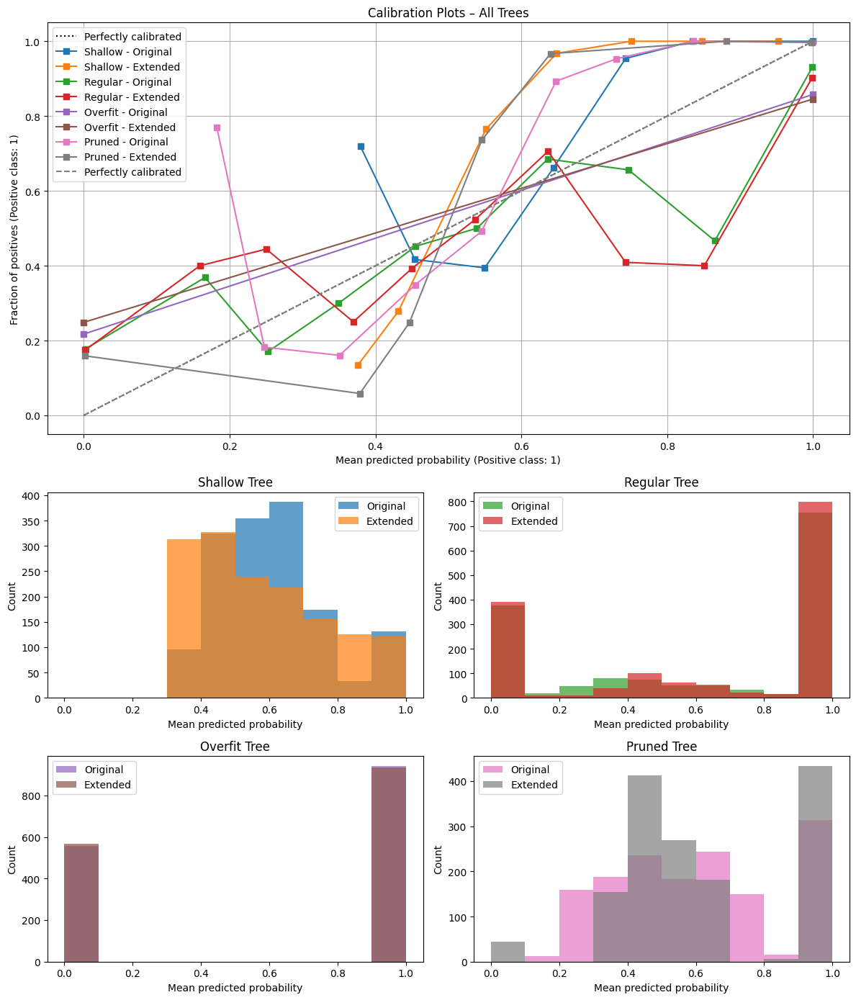

In [ ]:
# Call the plotting function
calibration.plot_lmt_combined_calibration_and_hists(
    X_test[:,:2], y_test,
    X_test, y_test,
    clfs=[original_models[0][0], original_models[1][0], original_models[2][0], original_models[3][0]],
    nodes=[original_models[0][1], original_models[1][1], original_models[2][1], original_models[3][1]],
    clfs_ext=[extended_models[0][0], extended_models[1][0], extended_models[2][0], extended_models[3][0]],
    nodes_ext=[extended_models[0][1], extended_models[1][1], extended_models[2][1], extended_models[3][1]],
    model_labels=["Shallow", "Regular", "Overfit", "Pruned"]
)

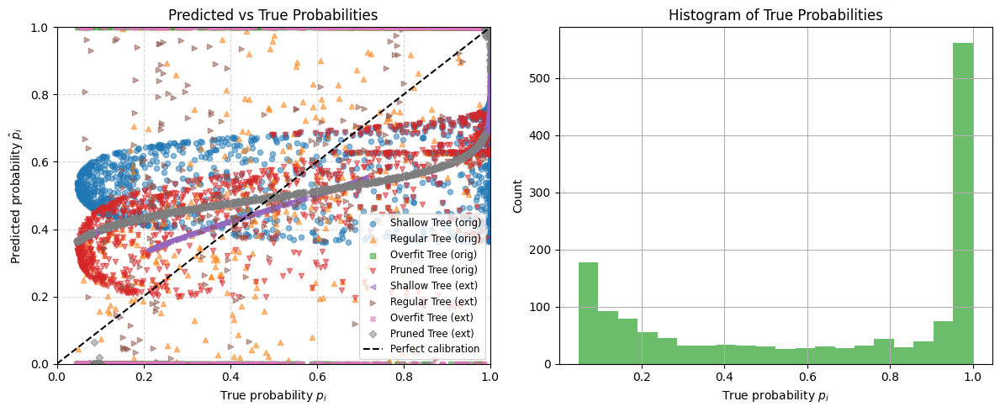

In [ ]:
models = {
    "Shallow Tree (orig)": (original_models[0][0], original_models[0][1]),
    "Regular Tree (orig)": (original_models[1][0], original_models[1][1]),
    "Overfit Tree (orig)": (original_models[2][0], original_models[2][1]),
    "Pruned Tree (orig)": (original_models[3][0], original_models[3][1]),
    "Shallow Tree (ext)": (extended_models[0][0], extended_models[0][1]),
    "Regular Tree (ext)": (extended_models[1][0], extended_models[1][1]),
    "Overfit Tree (ext)": (extended_models[2][0], extended_models[2][1]),
    "Pruned Tree (ext)": (extended_models[3][0], extended_models[3][1]),
}

p_true = expit(alpha * (X_test[:, 0]**2 + X_test[:, 1]**2 - r0))

calibration.plot_pred_vs_true(
    models=models,
    p_true=p_true,
    X_test=X_test,
    model_type='lmt',
    orig_cols=2,
    figsize=(12, 5)
)

C:\Users\allis\AppData\Local\Temp\ipykernel_2528\4048578742.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap(cmap_name, nq)


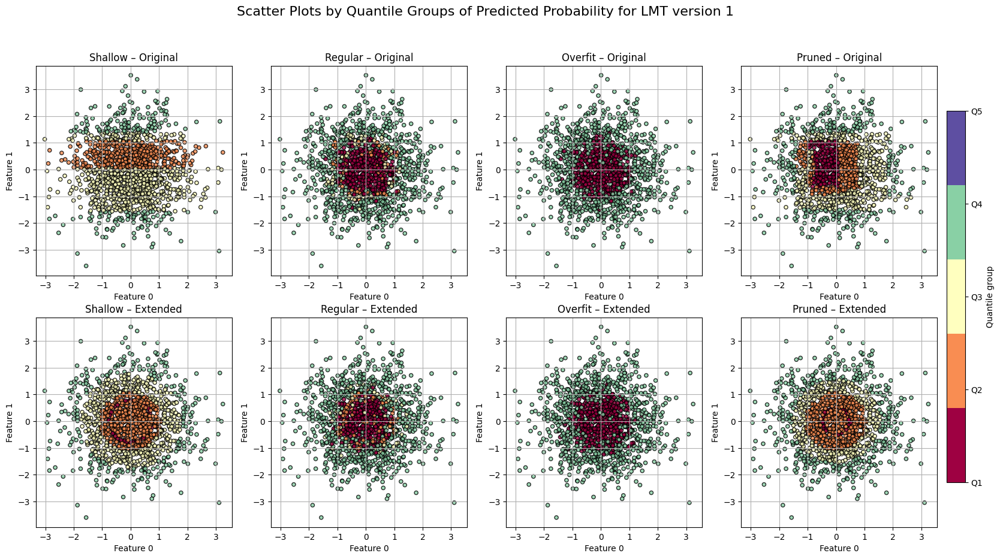

In [ ]:
# Step 1: Get predicted probabilities from all models
all_probas = []

for (clf, nodes) in zip(
                                [original_models[0][0], original_models[1][0], original_models[2][0], original_models[3][0]],
                                [original_models[0][1], original_models[1][1], original_models[2][1], original_models[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    all_probas.append(y_proba)

for (clf, nodes) in zip(
                                [extended_models[0][0], extended_models[1][0], extended_models[2][0], extended_models[3][0]],
                                [extended_models[0][1], extended_models[1][1], extended_models[2][1], extended_models[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    all_probas.append(y_proba)

all_probas = np.concatenate(all_probas)

# Step 2: Define consistent binning, norm, and colormap
nq = 5
q_edges = np.quantile(all_probas, np.linspace(0, 1, nq + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=nq - 1)
cmap_name = 'Spectral'
cmap = mpl.cm.get_cmap(cmap_name, nq)
model_labels = ["Shallow", "Regular", "Overfit", "Pruned"]

# Step 3: Create subplots
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))

# Top row: original (X_test[:, :2])
for idx, (clf, nodes) in enumerate(zip(
                                [original_models[0][0], original_models[1][0], original_models[2][0], original_models[3][0]],
                                [original_models[0][1], original_models[1][1], original_models[2][1], original_models[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    ax = axes[0, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Original",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )

# Bottom row: extended (predict on full X_test, still plot first 2 dims)
for idx, (clf, nodes) in enumerate(zip(
                                [extended_models[0][0], extended_models[1][0], extended_models[2][0], extended_models[3][0]],
                                [extended_models[0][1], extended_models[1][1], extended_models[2][1], extended_models[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    ax = axes[1, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Extended",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )


# Step 4: Shared colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=axes,
    orientation='vertical',
    fraction=0.02,
    pad=0.01
)
cbar.set_label("Quantile group")
cbar.set_ticks(np.arange(nq))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(nq)])

fig.suptitle("Scatter Plots by Quantile Groups of Predicted Probability for LMT version 1", fontsize=16)
plt.show()

## LMT version 2

In [7]:
from tqdm import tqdm
import time

original_models2 = []

configs = [
    ('shallow', False, "shallow (original)"),
    ('regular', False, "regular (original)"),
    ('overfit', False, "overfit (original)"),
    ('regular', True,  "pruned (original)")
]

for size, pruning, label in tqdm(configs, desc="Training original models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf2, nodes2 = lmt.fit_logistic_model_tree_v2(X_train[:, :2], y_train, size=size, pruning=pruning)
        original_models2.append((clf2, nodes2))
        pbar.update(1)
        print(f"{label} done")


Training original models:   0%|          | 0/4 [00:00<?, ?it/s]

Training original models:  25%|██▌       | 1/4 [00:16<00:50, 16.90s/it]

shallow (original) done


Training original models:  50%|█████     | 2/4 [00:44<00:46, 23.35s/it]

regular (original) done


Training original models:  75%|███████▌  | 3/4 [01:22<00:29, 29.71s/it]

overfit (original) done


Training original models: 100%|██████████| 4/4 [04:50<00:00, 72.52s/it] 

pruned (original) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.5918, Log Loss: 0.6238
Regular Tree (No Pruning) → Accuracy: 0.7911, Log Loss: 4.9289
Overfit Tree (No Pruning) → Accuracy: 0.8067, Log Loss: 2.8480
Regular Tree (With Pruning) → Accuracy: 0.7696, Log Loss: 4.3841


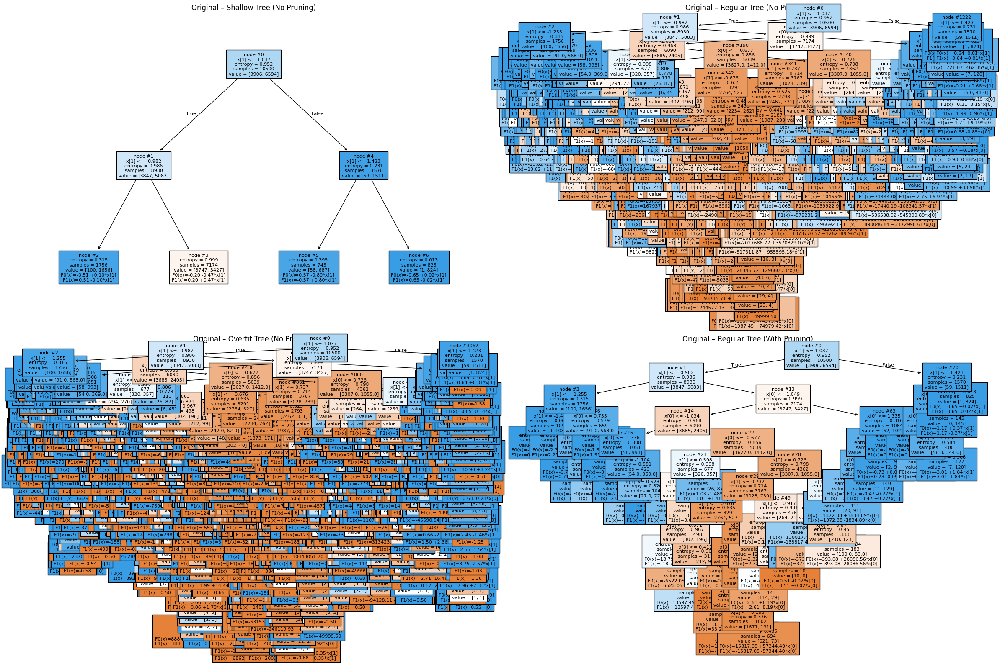

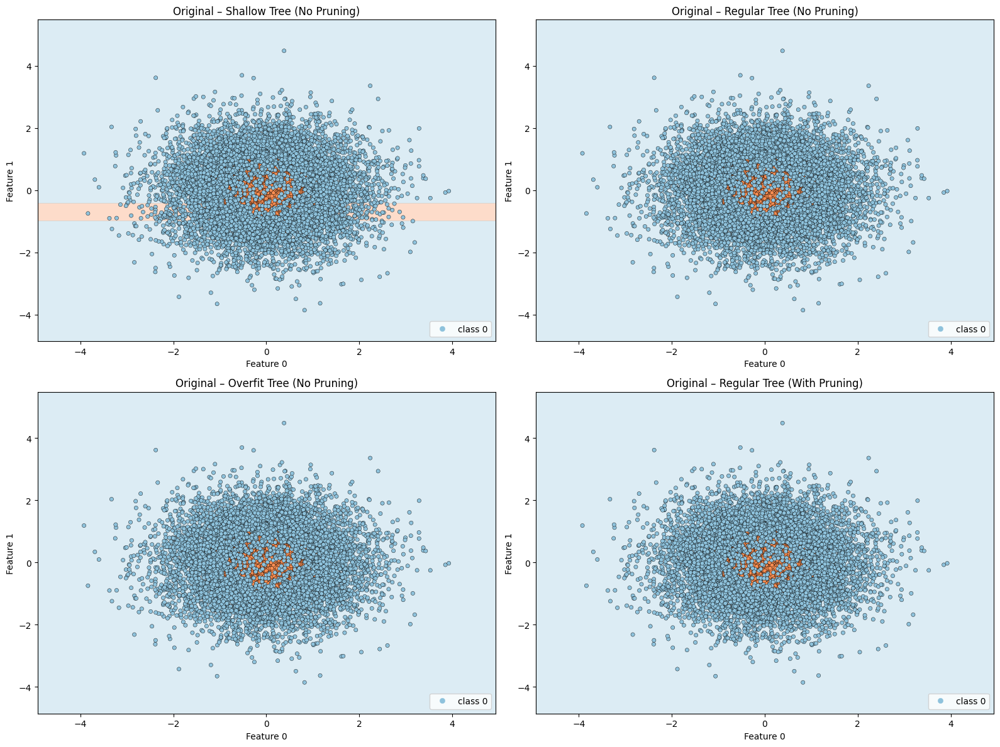

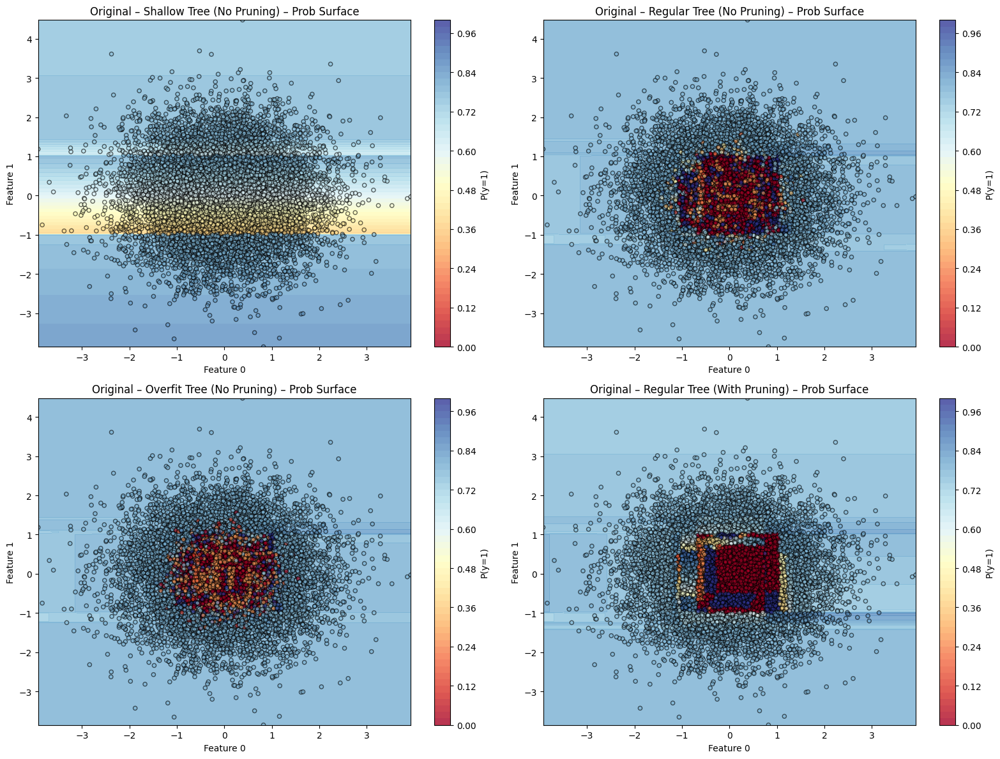

In [8]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train[:, :2],   # training data used for those models
    X_test=X_test[:, :2],     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v2',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=original_models2
)

In [9]:
extended_models2 = []

configs = [
    ('shallow', False, "shallow (extended)"),
    ('regular', False, "regular (extended)"),
    ('overfit', False, "overfit (extended)"),
    ('regular', True,  "pruned (extended)")
]

for size, pruning, label in tqdm(configs, desc="Training extended models"):
    with tqdm(total=1, desc=f"Training {label}", leave=True) as pbar:
        clf2, nodes2 = lmt.fit_logistic_model_tree_v2(X_train, y_train, size=size, pruning=pruning)
        extended_models2.append((clf2, nodes2))
        pbar.update(1)
        print(f"{label} done")

Training extended models:  25%|██▌       | 1/4 [00:19<00:58, 19.50s/it]

shallow (extended) done


Training extended models:  50%|█████     | 2/4 [01:17<01:23, 41.98s/it]

regular (extended) done


Training extended models:  75%|███████▌  | 3/4 [03:05<01:12, 72.48s/it]

overfit (extended) done


Training extended models: 100%|██████████| 4/4 [07:15<00:00, 108.82s/it]

pruned (extended) done


Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8678, Log Loss: 0.3010
Regular Tree (No Pruning) → Accuracy: 0.8053, Log Loss: 0.7409
Overfit Tree (No Pruning) → Accuracy: 0.8100, Log Loss: 0.9664
Regular Tree (With Pruning) → Accuracy: 0.8518, Log Loss: 0.3650


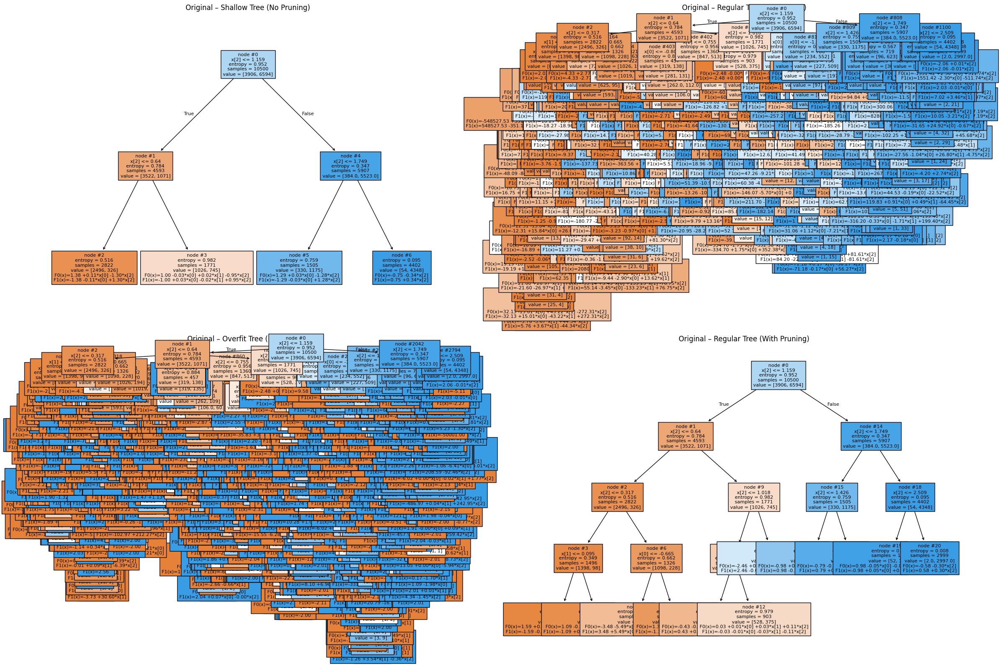

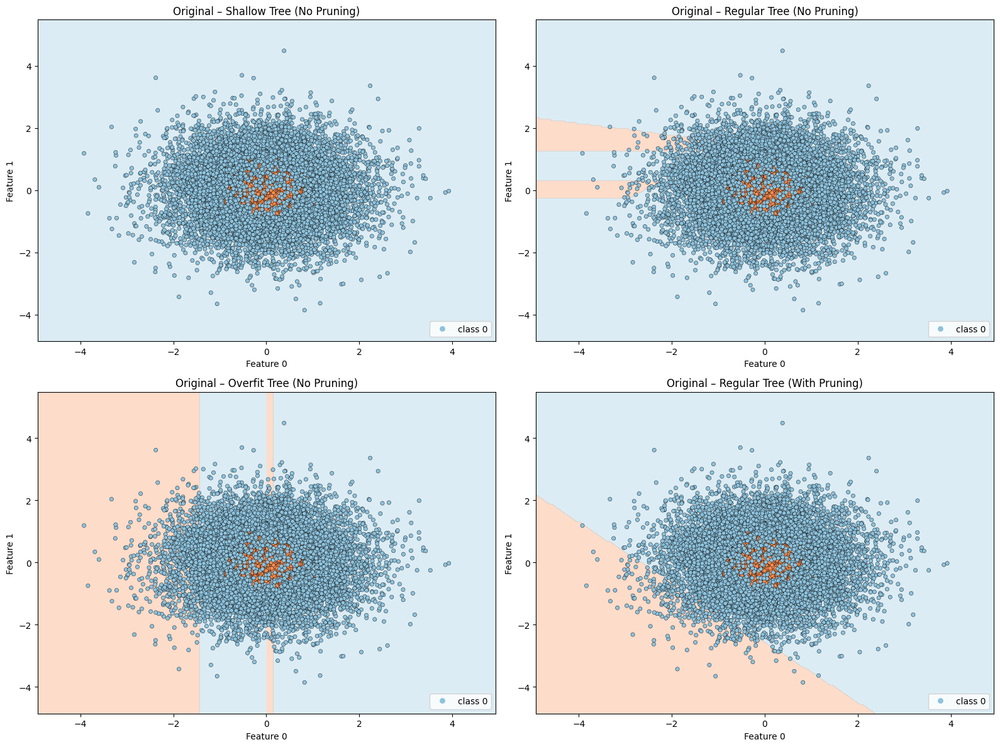

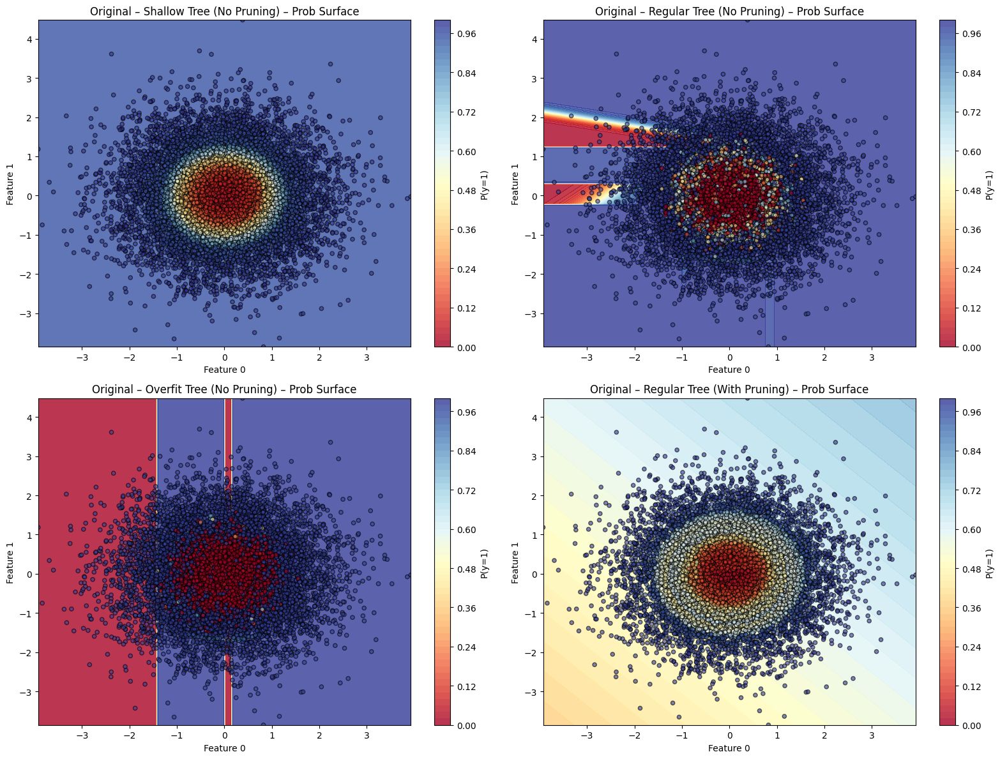

In [10]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v2',
    decision=True,
    prob_surf=True,
    feature_pair=(0, 1),
    original_models=extended_models2
)

Original Models Evaluation
Shallow Tree (No Pruning) → Accuracy: 0.8678, Log Loss: 0.3010
Regular Tree (No Pruning) → Accuracy: 0.8053, Log Loss: 0.7409
Overfit Tree (No Pruning) → Accuracy: 0.8100, Log Loss: 0.9664
Regular Tree (With Pruning) → Accuracy: 0.8518, Log Loss: 0.3650


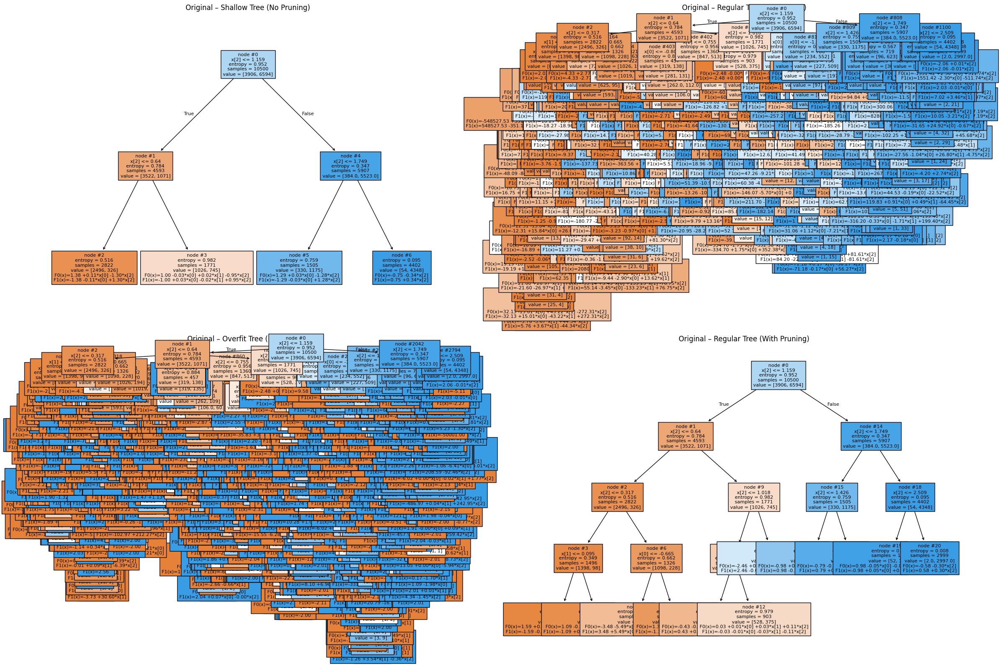

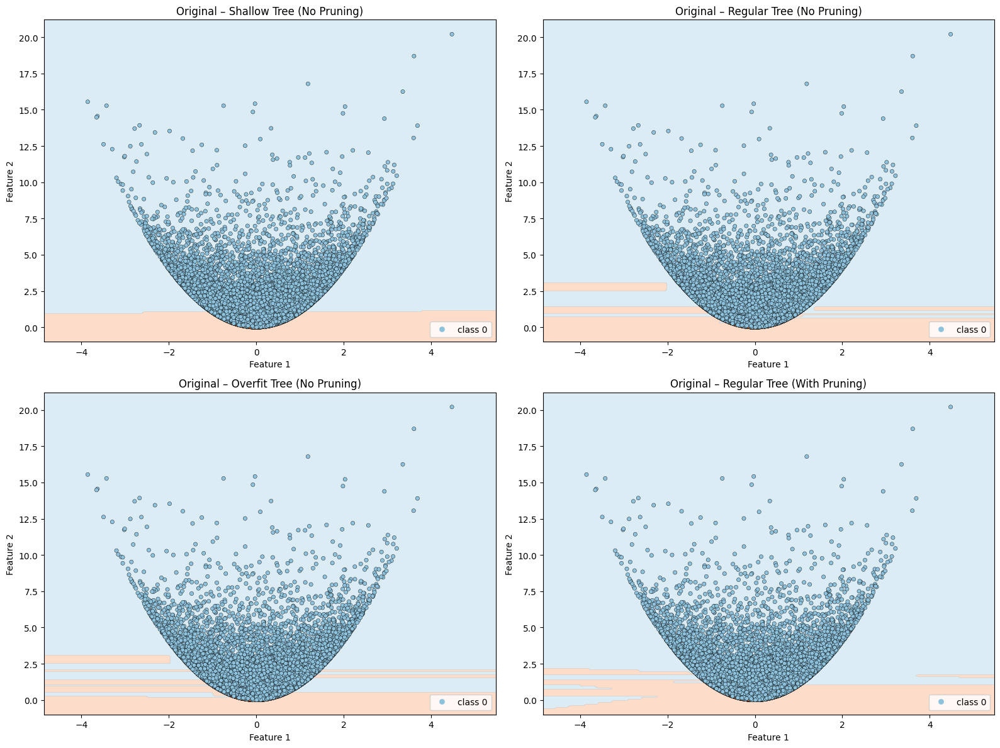

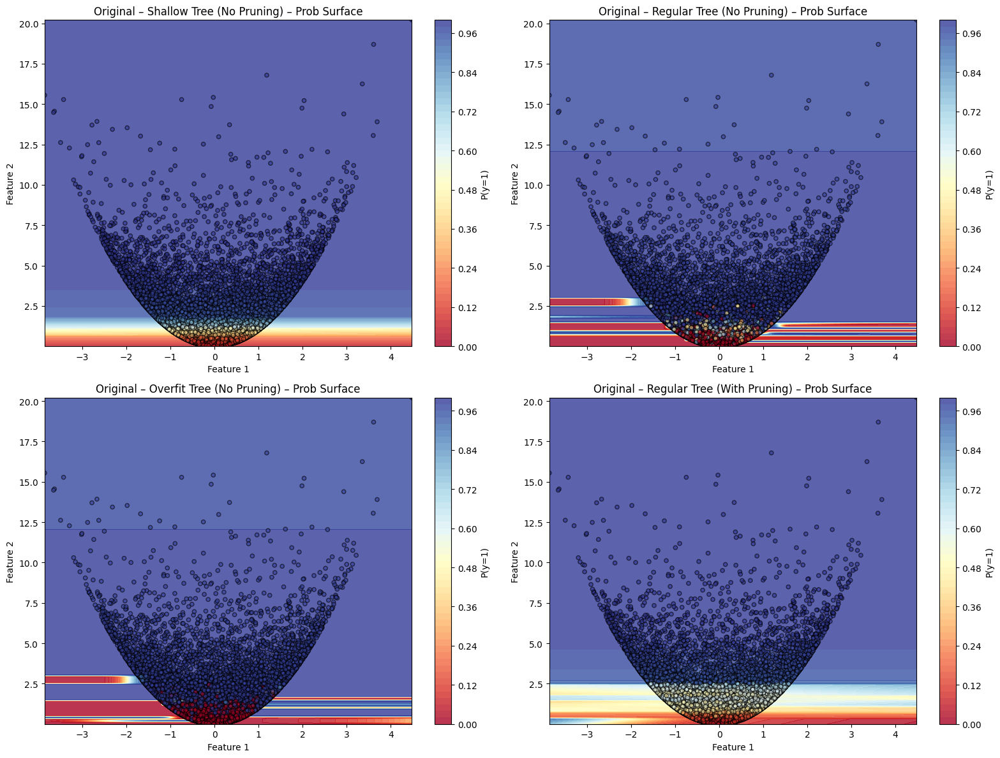

In [11]:
lmt.compare_lmt_variants_multiclass(
    X_train=X_train,   # training data used for those models
    X_test=X_test,     # must match feature shape
    y_train=y_train,
    y_test=y_test,
    lmt=lmt,
    version='v2',
    decision=True,
    prob_surf=True,
    feature_pair=(1, 2),
    original_models=extended_models2
)

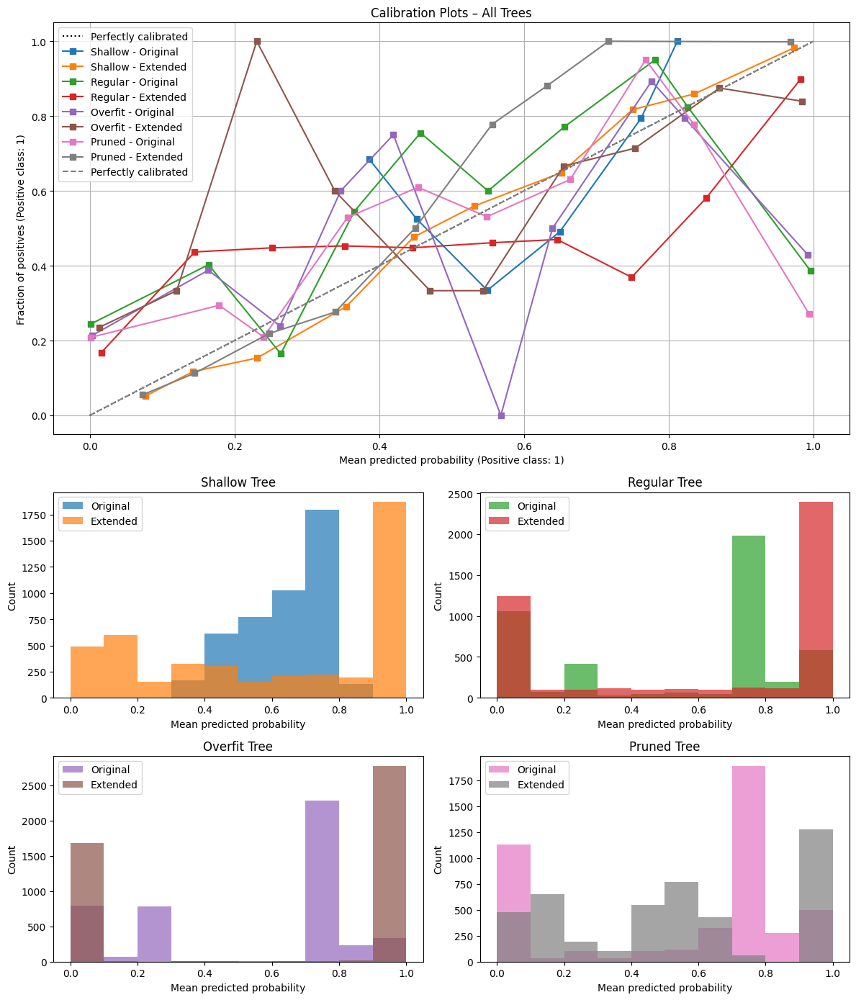

In [12]:
# Call the plotting function
calibration.plot_lmt_combined_calibration_and_hists(
    X_test[:,:2], y_test,
    X_test, y_test,
    clfs=[original_models2[0][0], original_models2[1][0], original_models2[2][0], original_models2[3][0]],
    nodes=[original_models2[0][1], original_models2[1][1], original_models2[2][1], original_models2[3][1]],
    clfs_ext=[extended_models2[0][0], extended_models2[1][0], extended_models2[2][0], extended_models2[3][0]],
    nodes_ext=[extended_models2[0][1], extended_models2[1][1], extended_models2[2][1], extended_models2[3][1]],
    model_labels=["Shallow", "Regular", "Overfit", "Pruned"]
)

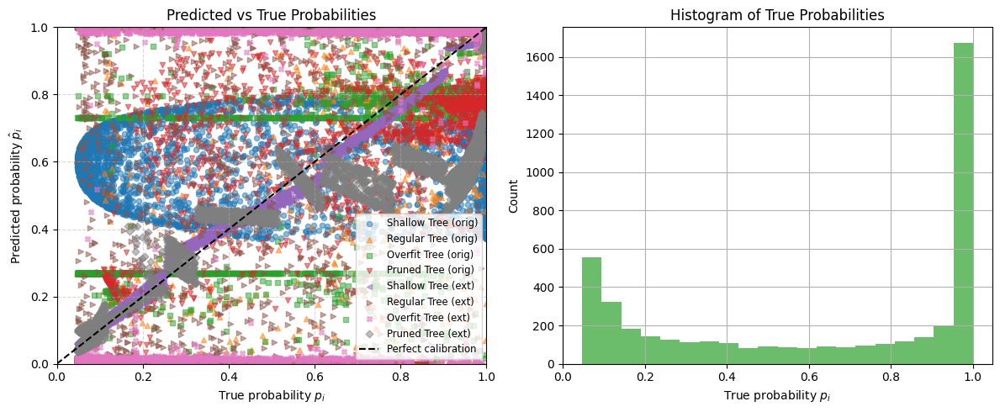

In [13]:
models = {
    "Shallow Tree (orig)": (original_models2[0][0], original_models2[0][1]),
    "Regular Tree (orig)": (original_models2[1][0], original_models2[1][1]),
    "Overfit Tree (orig)": (original_models2[2][0], original_models2[2][1]),
    "Pruned Tree (orig)": (original_models2[3][0], original_models2[3][1]),
    "Shallow Tree (ext)": (extended_models2[0][0], extended_models2[0][1]),
    "Regular Tree (ext)": (extended_models2[1][0], extended_models2[1][1]),
    "Overfit Tree (ext)": (extended_models2[2][0], extended_models2[2][1]),
    "Pruned Tree (ext)": (extended_models2[3][0], extended_models2[3][1]),
}

p_true = expit(alpha * (X_test[:, 0]**2 + X_test[:, 1]**2 - r0))

calibration.plot_pred_vs_true(
    models=models,
    p_true=p_true,
    X_test=X_test,
    model_type='lmt',
    orig_cols=2,
    figsize=(12, 5)
)

C:\Users\allis\AppData\Local\Temp\ipykernel_15752\3910529327.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = mpl.cm.get_cmap(cmap_name, nq)


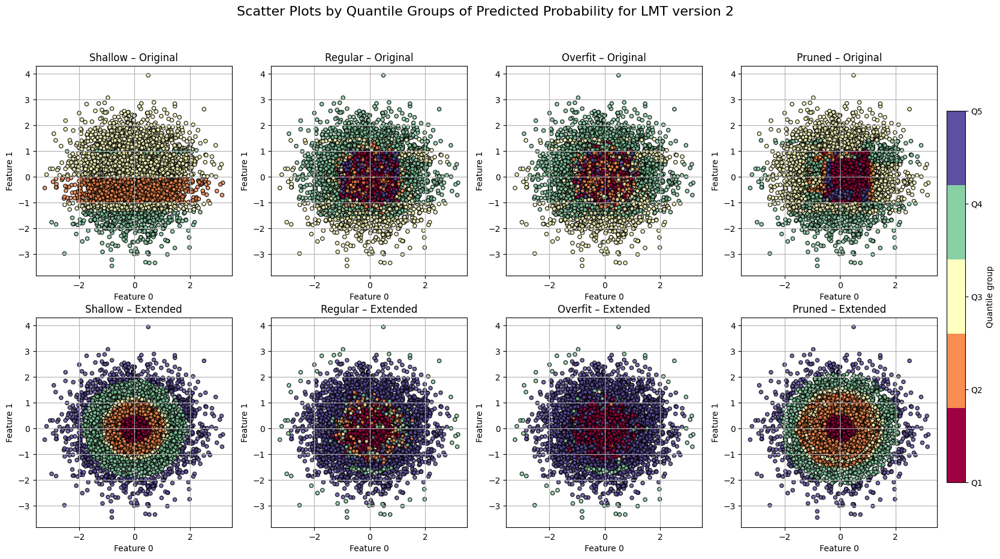

In [14]:
# Step 1: Get predicted probabilities from all models
all_probas = []

for (clf, nodes) in zip(
                                [original_models2[0][0], original_models2[1][0], original_models2[2][0], original_models2[3][0]],
                                [original_models2[0][1], original_models2[1][1], original_models2[2][1], original_models2[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    all_probas.append(y_proba)

for (clf, nodes) in zip(
                                [extended_models2[0][0], extended_models2[1][0], extended_models2[2][0], extended_models2[3][0]],
                                [extended_models2[0][1], extended_models2[1][1], extended_models2[2][1], extended_models2[3][1]]
    ):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    all_probas.append(y_proba)

all_probas = np.concatenate(all_probas)

# Step 2: Define consistent binning, norm, and colormap
nq = 5
q_edges = np.quantile(all_probas, np.linspace(0, 1, nq + 1))
norm = mpl.colors.Normalize(vmin=0, vmax=nq - 1)
cmap_name = 'Spectral'
cmap = mpl.cm.get_cmap(cmap_name, nq)
model_labels = ["Shallow", "Regular", "Overfit", "Pruned"]

# Step 3: Create subplots
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))

# Top row: original (X_test[:, :2])
for idx, (clf, nodes) in enumerate(zip(
                                [original_models2[0][0], original_models2[1][0], original_models2[2][0], original_models2[3][0]],
                                [original_models2[0][1], original_models2[1][1], original_models2[2][1], original_models2[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test[:, :2], clf, nodes)[:, 1]
    ax = axes[0, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Original",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )

# Bottom row: extended (predict on full X_test, still plot first 2 dims)
for idx, (clf, nodes) in enumerate(zip(
                                [extended_models2[0][0], extended_models2[1][0], extended_models2[2][0], extended_models2[3][0]],
                                [extended_models2[0][1], extended_models2[1][1], extended_models2[2][1], extended_models2[3][1]]
    )):
    y_proba = lmt.predict_proba_lmt_multiclass(X_test, clf, nodes)[:, 1]
    ax = axes[1, idx]
    calibration.plot_scatter_by_quantile(
        X_test[:, :2], y_proba,
        n_quantiles=nq,
        title=f"{model_labels[idx]} – Extended",
        ax=ax,
        feature_1=0,
        feature_2=1,
        cmap=cmap,
        norm=norm,
        q_edges=q_edges
    )


# Step 4: Shared colorbar
sm = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

cbar = fig.colorbar(
    sm,
    ax=axes,
    orientation='vertical',
    fraction=0.02,
    pad=0.01
)
cbar.set_label("Quantile group")
cbar.set_ticks(np.arange(nq))
cbar.set_ticklabels([f"Q{i + 1}" for i in range(nq)])

fig.suptitle("Scatter Plots by Quantile Groups of Predicted Probability for LMT version 2", fontsize=16)
plt.show()